# Configuration and Imports

In [1]:
import os
import glob
import random
import time
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
import matplotlib.pyplot as plt

# --- 1. Configuration ---
DEVICE = torch.device("mps" if torch.backends.mps.is_available() else "cpu")
print(f"🚀 Running on Device: {DEVICE}")

# Hyperparameters (Optimized for M1 Speed run)
IMG_SIZE = 128        # Reduced to 128 for speed
BATCH_SIZE = 16       # Increased batch size for stability
LR = 0.0002
B1 = 0.5
B2 = 0.999
N_EPOCHS = 100
LAMBDA_OT = 3.0       # Paper param
LAMBDA_GP = 5.0       # Paper param
NUM_CLASSES = 7       # LoveDA classes
DATA_ROOT = "./data"  # Your folder path

# --- 2. LoveDA Dataset Loader ---
class LoveDADataset(Dataset):
    def __init__(self, root_dir, split='Train', transform=None):
        self.transform = transform
        self.image_paths = sorted(glob.glob(os.path.join(root_dir, split, '*', 'images_png', '*.png')))
        # Map images to masks
        self.mask_paths = [p.replace('images_png', 'masks_png') for p in self.image_paths]

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img = Image.open(self.image_paths[idx]).convert('RGB')
        mask = Image.open(self.mask_paths[idx])

        # --- Label Fix ---
        # LoveDA uses 1-7. PyTorch needs 0-6.
        mask_np = np.array(mask)
        if mask_np.max() >= NUM_CLASSES:
            mask_np = mask_np - 1
        mask_np = np.clip(mask_np, 0, NUM_CLASSES - 1)
        mask = Image.fromarray(mask_np.astype(np.uint8))

        # Transforms
        if self.transform:
            # Resize/Crop to 128
            i, j, h, w = transforms.RandomCrop.get_params(img, output_size=(IMG_SIZE, IMG_SIZE))
            img = transforms.functional.crop(img, i, j, h, w)
            mask = transforms.functional.crop(mask, i, j, h, w)
            
            # Augmentation
            if random.random() > 0.5:
                img = transforms.functional.hflip(img)
                mask = transforms.functional.hflip(mask)

            # Normalize
            img = transforms.functional.to_tensor(img)
            img = transforms.functional.normalize(img, [0.5]*3, [0.5]*3)
            mask = torch.tensor(np.array(mask), dtype=torch.long)

        # One-Hot Encoding for SPADE
        mask_onehot = F.one_hot(mask, num_classes=NUM_CLASSES).permute(2, 0, 1).float()
        return {"image": img, "mask": mask_onehot}

# Load Data
transform = transforms.Compose([]) 
dataset = LoveDADataset(DATA_ROOT, split='Train', transform=transform)
dataloader = DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=0) # 0 workers for M1 stability

🚀 Running on Device: mps


In [2]:
# --- 3. Feature Magnification Module (FMM) ---
# Captures Global Style (Intraclass Variance)
class FMM(nn.Module):
    def __init__(self, in_channels):
        super(FMM, self).__init__()
        # Input: Max + Avg + Min stats
        self.mlp = nn.Sequential(
            nn.Linear(in_channels * 3, in_channels),
            nn.ReLU(),
            nn.Linear(in_channels, in_channels),
            nn.Sigmoid()
        )

    def forward(self, x):
        b, c, _, _ = x.size()
        # Flatten spatial dims
        flat = x.view(b, c, -1)
        # Calculate Global Stats
        max_pool = torch.max(flat, dim=2)[0]
        avg_pool = torch.mean(flat, dim=2)
        min_pool = torch.min(flat, dim=2)[0]
        
        stats = torch.cat([max_pool, avg_pool, min_pool], dim=1)
        attn = self.mlp(stats).view(b, c, 1, 1)
        
        # Magnify
        return x + (x * attn)

# --- 4. Feature Aggregation Module (FAM) ---
# Captures Spatial Detail (Interclass Variance)
class FAM(nn.Module):
    def __init__(self, in_channels):
        super(FAM, self).__init__()
        # Multi-scale kernels
        self.c1 = nn.Conv2d(in_channels, in_channels, 1, padding=0)
        self.c3 = nn.Conv2d(in_channels, in_channels, 3, padding=1)
        self.c5 = nn.Conv2d(in_channels, in_channels, 5, padding=2)
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        # Aggregate different receptive fields
        out = self.c1(x) + self.c3(x) + self.c5(x)
        attn = self.sigmoid(out)
        return x * attn

In [3]:
# --- SPADE Normalization ---
class SPADE(nn.Module):
    def __init__(self, norm_nc, label_nc):
        super().__init__()
        self.bn = nn.BatchNorm2d(norm_nc, affine=False)
        self.mlp_shared = nn.Sequential(nn.Conv2d(label_nc, 128, 3, 1, 1), nn.ReLU())
        self.gamma = nn.Conv2d(128, norm_nc, 3, 1, 1)
        self.beta = nn.Conv2d(128, norm_nc, 3, 1, 1)

    def forward(self, x, seg):
        # Downsample segmentation to match x
        seg = F.interpolate(seg, size=x.size()[2:], mode='nearest')
        actv = self.mlp_shared(seg)
        gamma = self.gamma(actv)
        beta = self.beta(actv)
        return self.bn(x) * (1 + gamma) + beta

class SPADEResBlk(nn.Module):
    def __init__(self, fin, fout, label_nc):
        super().__init__()
        self.learned_shortcut = (fin != fout)
        self.conv_s = nn.Conv2d(fin, fout, 1, bias=False) if self.learned_shortcut else None
        self.spade_s = SPADE(fin, label_nc) if self.learned_shortcut else None
        
        self.conv_0 = nn.Conv2d(fin, fout, 3, 1, 1)
        self.spade_0 = SPADE(fin, label_nc)
        
        self.conv_1 = nn.Conv2d(fout, fout, 3, 1, 1)
        self.spade_1 = SPADE(fout, label_nc)
        self.act = nn.LeakyReLU(0.2)

    def forward(self, x, seg):
        x_s = self.conv_s(self.act(self.spade_s(x, seg))) if self.learned_shortcut else x
        dx = self.conv_0(self.act(self.spade_0(x, seg)))
        dx = self.conv_1(self.act(self.spade_1(dx, seg)))
        return x_s + dx

# --- Main Generator ---
class Generator(nn.Module):
    def __init__(self, label_nc=7):
        super().__init__()
        self.fc = nn.Conv2d(label_nc, 512, 3, padding=1)
        
        # Insert Papers Modules Here
        self.fmm = FMM(512)
        self.fam = FAM(512)
        
        # Upsampling Blocks (5 layers for 4->128 upsampling)
        self.head_0 = SPADEResBlk(512, 512, label_nc)
        self.head_1 = SPADEResBlk(512, 512, label_nc)
        self.head_2 = SPADEResBlk(512, 256, label_nc)
        self.head_3 = SPADEResBlk(256, 128, label_nc)
        self.head_4 = SPADEResBlk(128, 64, label_nc)
        
        self.conv_img = nn.Conv2d(64, 3, 3, 1, 1)
        self.up = nn.Upsample(scale_factor=2)

    def forward(self, seg):
        # Dynamic Start Size: 128 / 32 = 4x4
        k = IMG_SIZE // 32
        seg_small = F.interpolate(seg, size=(k, k), mode='nearest')
        
        # Encode
        x = self.fc(seg_small)
        x = self.fmm(x) # Apply FMM
        x = self.fam(x) # Apply FAM
        
        # Decode
        x = self.head_0(x, seg); x = self.up(x) # -> 8
        x = self.head_1(x, seg); x = self.up(x) # -> 16
        x = self.head_2(x, seg); x = self.up(x) # -> 32
        x = self.head_3(x, seg); x = self.up(x) # -> 64
        x = self.head_4(x, seg); x = self.up(x) # -> 128
        
        return torch.tanh(self.conv_img(F.leaky_relu(x, 0.2)))

In [4]:
# --- Discriminator with Spectral Norm ---
class Discriminator(nn.Module):
    def __init__(self, label_nc=7):
        super().__init__()
        # Takes Image (3) + Label (7)
        def block(in_c, out_c, norm=True):
            layers = [nn.utils.spectral_norm(nn.Conv2d(in_c, out_c, 4, 2, 1))]
            if norm: layers.append(nn.InstanceNorm2d(out_c))
            layers.append(nn.LeakyReLU(0.2))
            return layers

        self.model = nn.ModuleList([
            nn.Sequential(*block(3 + label_nc, 64, False)),
            nn.Sequential(*block(64, 128)),
            nn.Sequential(*block(128, 256)),
            nn.Sequential(*block(256, 512))
        ])
        self.final = nn.Conv2d(512, 1, 4, 1, 1)

    def forward(self, img, seg):
        x = torch.cat([img, seg], 1)
        feats = []
        for layer in self.model:
            x = layer(x)
            feats.append(x) # Save features for OT Loss
        return self.final(x), feats

# --- Losses ---
def compute_ot_loss(fake_feats, real_feats):
    loss = 0
    for f, r in zip(fake_feats, real_feats):
        # Simple L2 over features (Brenier approximation)
        loss += torch.sum((f - r) ** 2) / f.numel()
    return loss / 2.0

def compute_gp(D, real, fake, seg):
    # Gradient Penalty for Lipschitz continuity
    alpha = torch.rand(real.size(0), 1, 1, 1).to(DEVICE)
    interp = (alpha * real + (1 - alpha) * fake).requires_grad_(True)
    d_out, _ = D(interp, seg)
    
    grad = torch.autograd.grad(
        outputs=d_out, inputs=interp,
        grad_outputs=torch.ones_like(d_out),
        create_graph=True, retain_graph=True, only_inputs=True
    )[0]
    grad = grad.view(grad.size(0), -1)
    return ((grad.norm(2, dim=1) - 1) ** 2).mean()

📸 Creating fixed visualization batch...
🔥 Models Initialized. Starting Training...
[Ep 0][Bt 0] D:567.389 G:1.837 OT:0.676 T:0.2m
[Ep 0][Bt 20] D:3.558 G:1.965 OT:0.672 T:0.8m
[Ep 0][Bt 40] D:0.533 G:1.970 OT:0.660 T:1.5m
[Ep 0][Bt 60] D:2.085 G:2.243 OT:0.751 T:2.1m
[Ep 0][Bt 80] D:0.642 G:1.394 OT:0.453 T:2.7m
[Ep 0][Bt 100] D:0.196 G:1.855 OT:0.589 T:3.3m
[Ep 0][Bt 120] D:0.772 G:1.582 OT:0.479 T:4.0m
[Ep 0][Bt 140] D:0.281 G:1.555 OT:0.477 T:4.6m


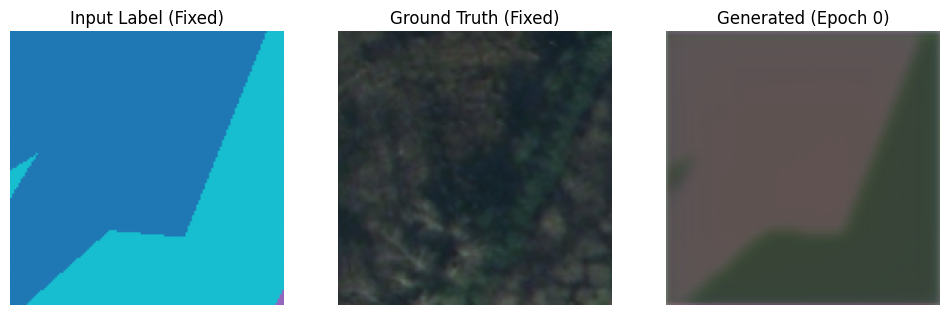

[Ep 1][Bt 0] D:0.214 G:1.732 OT:0.524 T:5.4m
[Ep 1][Bt 20] D:0.139 G:1.781 OT:0.535 T:6.1m
[Ep 1][Bt 40] D:0.159 G:1.673 OT:0.474 T:6.8m
[Ep 1][Bt 60] D:0.078 G:2.093 OT:0.603 T:7.4m
[Ep 1][Bt 80] D:0.258 G:1.665 OT:0.476 T:8.0m
[Ep 1][Bt 100] D:0.111 G:1.366 OT:0.364 T:8.6m
[Ep 1][Bt 120] D:0.246 G:1.785 OT:0.481 T:9.2m
[Ep 1][Bt 140] D:-0.047 G:1.745 OT:0.466 T:9.9m


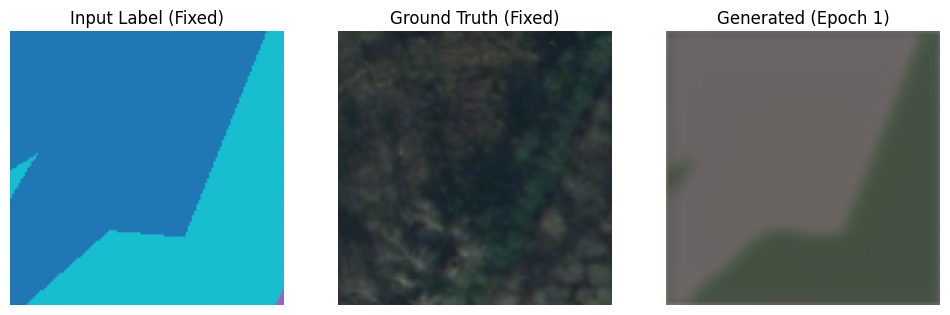

[Ep 2][Bt 0] D:-0.061 G:1.625 OT:0.428 T:10.5m
[Ep 2][Bt 20] D:0.065 G:1.864 OT:0.477 T:11.1m
[Ep 2][Bt 40] D:-0.064 G:2.119 OT:0.575 T:11.7m
[Ep 2][Bt 60] D:-0.107 G:2.306 OT:0.646 T:12.3m
[Ep 2][Bt 80] D:0.048 G:1.652 OT:0.404 T:13.0m
[Ep 2][Bt 100] D:0.070 G:1.646 OT:0.405 T:13.8m
[Ep 2][Bt 120] D:-0.029 G:1.685 OT:0.405 T:14.5m
[Ep 2][Bt 140] D:-0.042 G:1.898 OT:0.474 T:15.2m


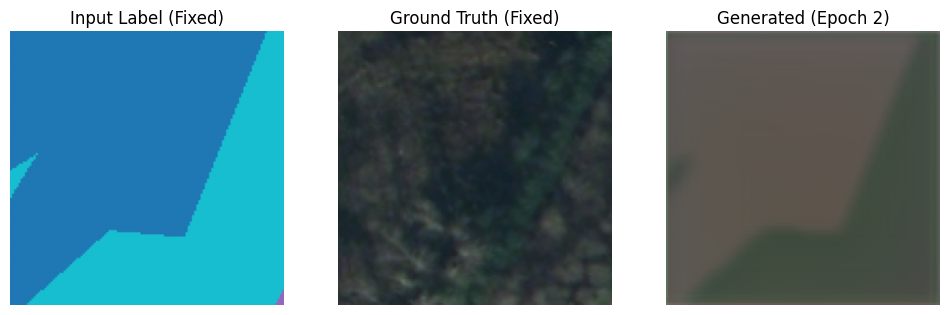

[Ep 3][Bt 0] D:-0.100 G:1.931 OT:0.480 T:15.8m
[Ep 3][Bt 20] D:-0.060 G:1.777 OT:0.431 T:16.4m
[Ep 3][Bt 40] D:-0.108 G:2.273 OT:0.584 T:17.1m
[Ep 3][Bt 60] D:-0.093 G:1.939 OT:0.483 T:17.8m
[Ep 3][Bt 80] D:-0.155 G:2.091 OT:0.504 T:18.4m
[Ep 3][Bt 100] D:-0.078 G:2.233 OT:0.547 T:19.0m
[Ep 3][Bt 120] D:-0.172 G:2.160 OT:0.519 T:19.7m
[Ep 3][Bt 140] D:-0.170 G:2.413 OT:0.615 T:20.3m


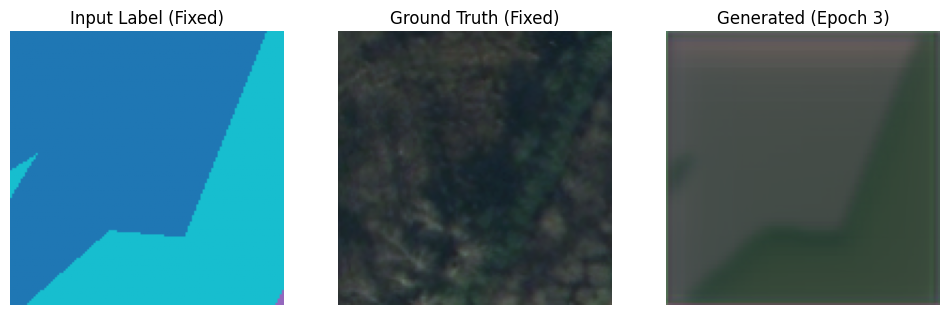

[Ep 4][Bt 0] D:-0.158 G:1.926 OT:0.439 T:20.9m
[Ep 4][Bt 20] D:-0.172 G:2.363 OT:0.557 T:21.5m
[Ep 4][Bt 40] D:-0.066 G:1.992 OT:0.434 T:22.2m
[Ep 4][Bt 60] D:0.140 G:2.071 OT:0.446 T:22.8m
[Ep 4][Bt 80] D:-0.202 G:2.340 OT:0.524 T:23.5m
[Ep 4][Bt 100] D:-0.151 G:1.985 OT:0.400 T:24.1m
[Ep 4][Bt 120] D:-0.155 G:1.880 OT:0.374 T:24.8m
[Ep 4][Bt 140] D:-0.187 G:2.093 OT:0.443 T:25.4m


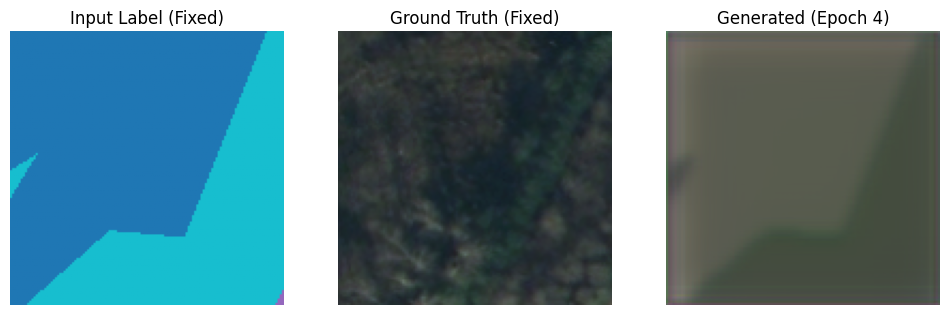

[Ep 5][Bt 0] D:-0.124 G:1.945 OT:0.385 T:26.0m
[Ep 5][Bt 20] D:-0.254 G:2.428 OT:0.527 T:26.7m
[Ep 5][Bt 40] D:-0.142 G:2.218 OT:0.457 T:27.5m
[Ep 5][Bt 60] D:-0.176 G:2.299 OT:0.501 T:28.2m
[Ep 5][Bt 80] D:-0.281 G:2.390 OT:0.497 T:28.9m
[Ep 5][Bt 100] D:-0.191 G:2.138 OT:0.388 T:29.6m
[Ep 5][Bt 120] D:-0.112 G:2.463 OT:0.538 T:30.3m
[Ep 5][Bt 140] D:-0.313 G:2.588 OT:0.547 T:31.0m


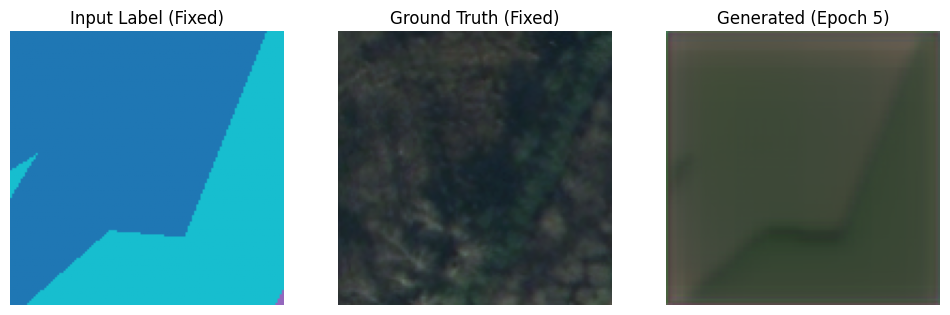

[Ep 6][Bt 0] D:-0.136 G:2.186 OT:0.395 T:31.6m
[Ep 6][Bt 20] D:-0.144 G:2.173 OT:0.402 T:32.3m
[Ep 6][Bt 40] D:-0.221 G:2.277 OT:0.417 T:33.0m
[Ep 6][Bt 60] D:-0.213 G:2.549 OT:0.531 T:33.7m
[Ep 6][Bt 80] D:-0.312 G:2.574 OT:0.485 T:34.3m
[Ep 6][Bt 100] D:-0.257 G:2.556 OT:0.503 T:35.0m
[Ep 6][Bt 120] D:-0.136 G:2.160 OT:0.361 T:35.7m
[Ep 6][Bt 140] D:-0.230 G:2.368 OT:0.422 T:36.4m


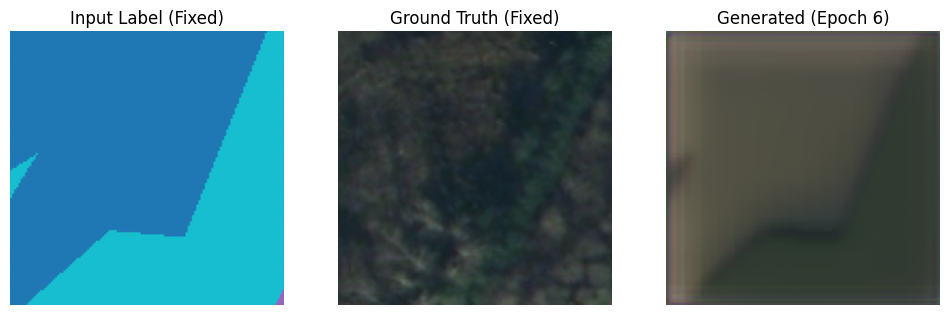

[Ep 7][Bt 0] D:-0.188 G:2.010 OT:0.291 T:37.0m
[Ep 7][Bt 20] D:-0.374 G:2.622 OT:0.491 T:37.7m
[Ep 7][Bt 40] D:-0.273 G:2.360 OT:0.378 T:38.4m
[Ep 7][Bt 60] D:-0.121 G:2.032 OT:0.314 T:39.1m
[Ep 7][Bt 80] D:-0.239 G:2.578 OT:0.455 T:39.7m
[Ep 7][Bt 100] D:-0.225 G:2.175 OT:0.310 T:43.2m
[Ep 7][Bt 120] D:-0.216 G:2.431 OT:0.398 T:43.8m
[Ep 7][Bt 140] D:-0.188 G:2.821 OT:0.569 T:44.4m


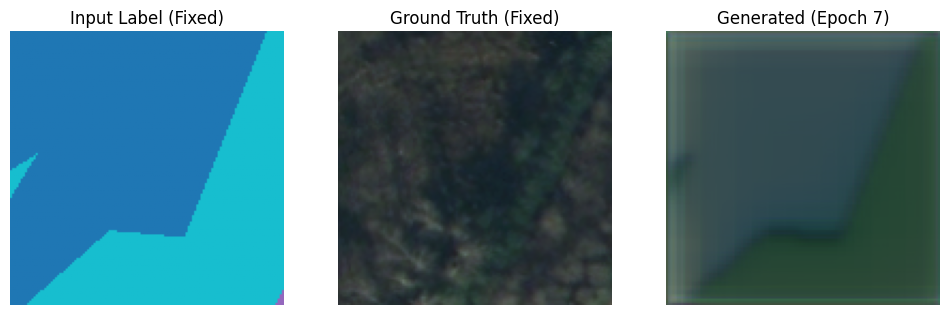

[Ep 8][Bt 0] D:-0.355 G:2.716 OT:0.473 T:44.9m
[Ep 8][Bt 20] D:-0.174 G:2.189 OT:0.307 T:45.5m
[Ep 8][Bt 40] D:-0.379 G:2.670 OT:0.451 T:46.1m
[Ep 8][Bt 60] D:-0.294 G:2.774 OT:0.505 T:46.8m
[Ep 8][Bt 80] D:-0.244 G:2.334 OT:0.351 T:47.4m
[Ep 8][Bt 100] D:-0.208 G:2.364 OT:0.336 T:48.0m
[Ep 8][Bt 120] D:-0.187 G:2.460 OT:0.415 T:48.6m
[Ep 8][Bt 140] D:-0.276 G:2.389 OT:0.336 T:49.2m


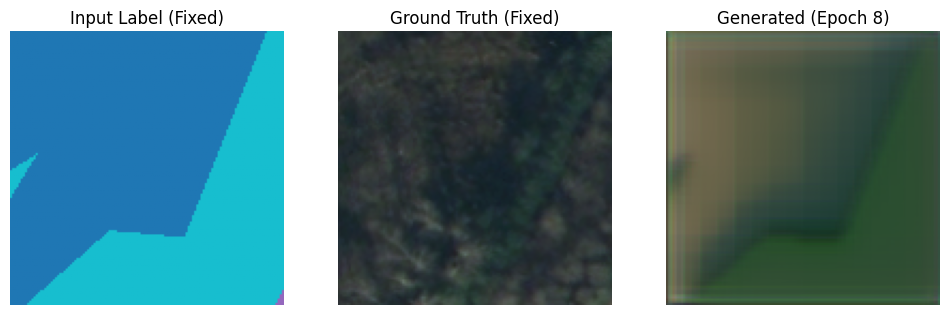

[Ep 9][Bt 0] D:-0.296 G:2.836 OT:0.492 T:49.8m
[Ep 9][Bt 20] D:-0.321 G:2.825 OT:0.497 T:50.4m
[Ep 9][Bt 40] D:-0.084 G:2.312 OT:0.319 T:51.0m
[Ep 9][Bt 60] D:-0.226 G:2.403 OT:0.337 T:51.6m
[Ep 9][Bt 80] D:-0.204 G:2.569 OT:0.389 T:52.2m
[Ep 9][Bt 100] D:-0.425 G:2.994 OT:0.507 T:52.9m
[Ep 9][Bt 120] D:-0.178 G:2.482 OT:0.360 T:53.5m
[Ep 9][Bt 140] D:-0.191 G:2.339 OT:0.298 T:54.1m


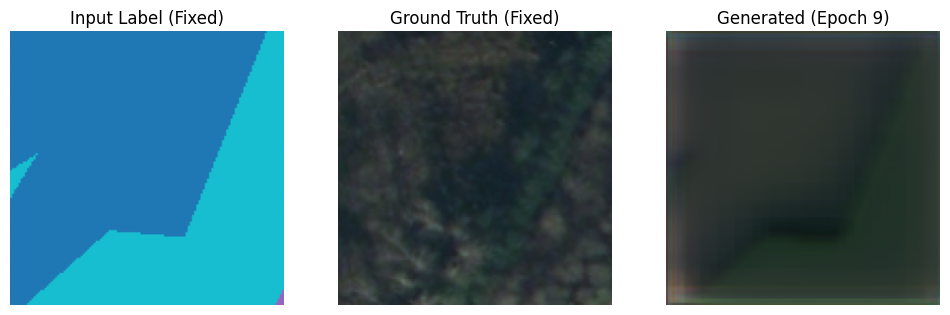

[Ep 10][Bt 0] D:-0.214 G:2.407 OT:0.314 T:54.7m
[Ep 10][Bt 20] D:-0.278 G:2.626 OT:0.408 T:55.3m
[Ep 10][Bt 40] D:-0.247 G:2.359 OT:0.315 T:56.0m
[Ep 10][Bt 60] D:-0.234 G:2.701 OT:0.419 T:56.6m
[Ep 10][Bt 80] D:-0.292 G:2.880 OT:0.477 T:57.2m
[Ep 10][Bt 100] D:-0.364 G:2.653 OT:0.383 T:57.9m
[Ep 10][Bt 120] D:-0.315 G:2.826 OT:0.460 T:58.6m
[Ep 10][Bt 140] D:-0.091 G:2.614 OT:0.368 T:59.2m


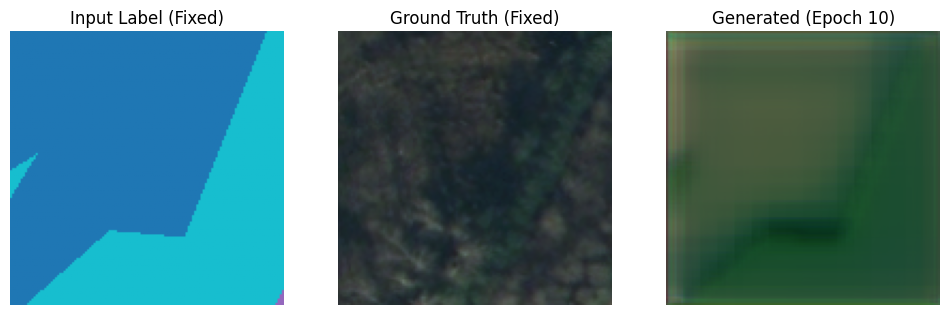

[Ep 11][Bt 0] D:-0.266 G:2.420 OT:0.280 T:59.8m
[Ep 11][Bt 20] D:-0.222 G:2.564 OT:0.371 T:60.4m
[Ep 11][Bt 40] D:-0.269 G:2.571 OT:0.340 T:61.0m
[Ep 11][Bt 60] D:-0.254 G:2.706 OT:0.360 T:61.7m
[Ep 11][Bt 80] D:-0.126 G:2.597 OT:0.338 T:62.3m
[Ep 11][Bt 100] D:-0.243 G:2.654 OT:0.351 T:62.9m
[Ep 11][Bt 120] D:-0.043 G:2.425 OT:0.301 T:63.5m
[Ep 11][Bt 140] D:-0.226 G:2.474 OT:0.307 T:64.1m


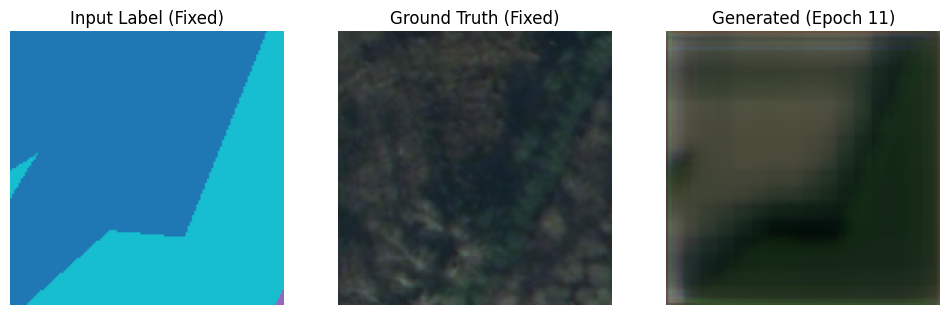

[Ep 12][Bt 0] D:-0.100 G:2.629 OT:0.379 T:64.7m
[Ep 12][Bt 20] D:-0.111 G:2.641 OT:0.423 T:65.3m
[Ep 12][Bt 40] D:-0.077 G:2.605 OT:0.380 T:65.9m
[Ep 12][Bt 60] D:-0.233 G:2.677 OT:0.348 T:66.5m
[Ep 12][Bt 80] D:-0.298 G:2.798 OT:0.412 T:67.2m
[Ep 12][Bt 100] D:-0.169 G:2.698 OT:0.381 T:67.8m
[Ep 12][Bt 120] D:-0.279 G:2.814 OT:0.377 T:68.4m
[Ep 12][Bt 140] D:-0.152 G:2.512 OT:0.278 T:69.1m


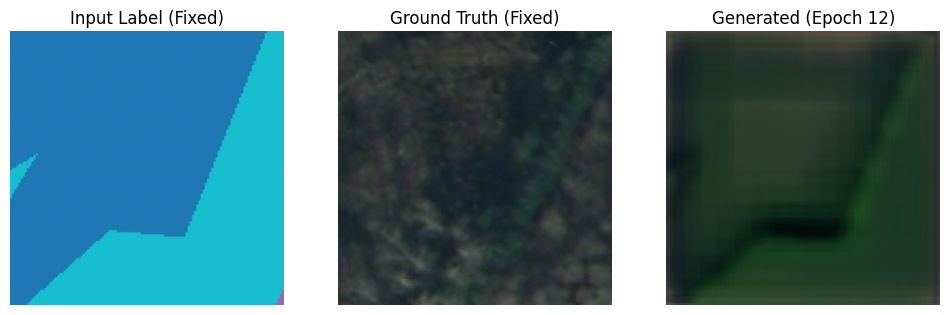

[Ep 13][Bt 0] D:-0.184 G:2.858 OT:0.413 T:69.7m
[Ep 13][Bt 20] D:-0.223 G:2.770 OT:0.376 T:70.4m
[Ep 13][Bt 40] D:-0.122 G:2.527 OT:0.294 T:71.0m
[Ep 13][Bt 60] D:-0.225 G:2.510 OT:0.261 T:71.6m
[Ep 13][Bt 80] D:-0.214 G:2.735 OT:0.330 T:72.3m
[Ep 13][Bt 100] D:-0.085 G:2.760 OT:0.376 T:72.9m
[Ep 13][Bt 120] D:-0.088 G:2.602 OT:0.332 T:73.5m
[Ep 13][Bt 140] D:-0.289 G:2.771 OT:0.365 T:74.2m


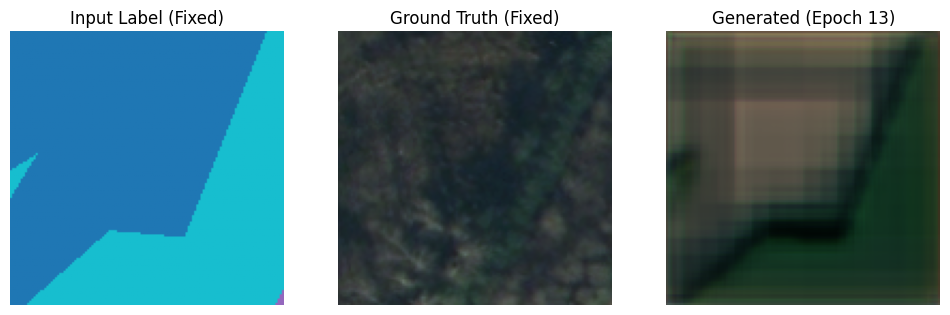

[Ep 14][Bt 0] D:-0.172 G:2.584 OT:0.287 T:74.8m
[Ep 14][Bt 20] D:-0.160 G:2.613 OT:0.293 T:75.4m
[Ep 14][Bt 40] D:-0.253 G:2.724 OT:0.331 T:76.0m
[Ep 14][Bt 60] D:-0.187 G:2.724 OT:0.325 T:76.6m
[Ep 14][Bt 80] D:-0.273 G:2.726 OT:0.325 T:77.2m
[Ep 14][Bt 100] D:-0.144 G:2.655 OT:0.271 T:77.8m
[Ep 14][Bt 120] D:-0.116 G:2.742 OT:0.369 T:78.4m
[Ep 14][Bt 140] D:-0.239 G:2.762 OT:0.357 T:79.1m


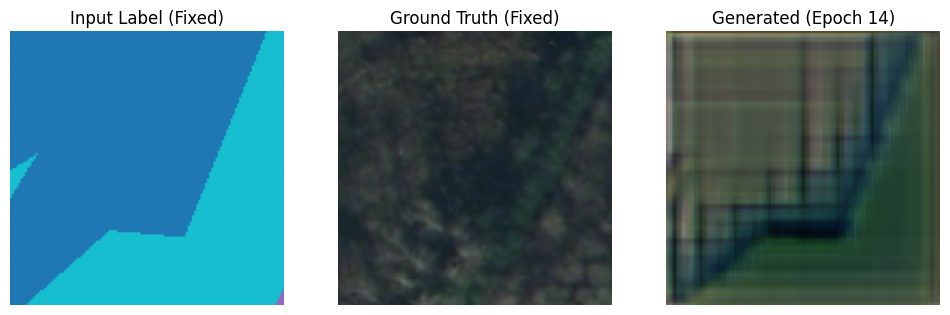

[Ep 15][Bt 0] D:-0.153 G:2.686 OT:0.290 T:79.7m
[Ep 15][Bt 20] D:-0.147 G:2.612 OT:0.267 T:80.3m
[Ep 15][Bt 40] D:-0.140 G:2.629 OT:0.310 T:81.0m
[Ep 15][Bt 60] D:-0.175 G:2.667 OT:0.306 T:81.6m
[Ep 15][Bt 80] D:-0.153 G:2.612 OT:0.271 T:82.2m
[Ep 15][Bt 100] D:-0.320 G:2.820 OT:0.354 T:82.9m
[Ep 15][Bt 120] D:-0.159 G:2.844 OT:0.384 T:83.5m
[Ep 15][Bt 140] D:-0.220 G:2.797 OT:0.339 T:84.2m


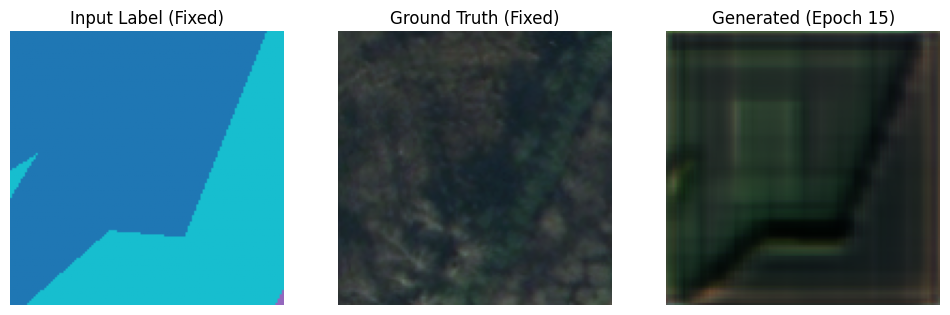

[Ep 16][Bt 0] D:-0.288 G:2.932 OT:0.356 T:84.7m
[Ep 16][Bt 20] D:-0.168 G:2.837 OT:0.361 T:85.4m
[Ep 16][Bt 40] D:-0.124 G:2.603 OT:0.242 T:86.0m
[Ep 16][Bt 60] D:-0.210 G:2.845 OT:0.336 T:86.7m
[Ep 16][Bt 80] D:-0.182 G:2.764 OT:0.322 T:87.3m
[Ep 16][Bt 100] D:-0.293 G:2.935 OT:0.358 T:87.9m
[Ep 16][Bt 120] D:-0.103 G:2.586 OT:0.280 T:88.6m
[Ep 16][Bt 140] D:-0.139 G:2.582 OT:0.244 T:89.2m


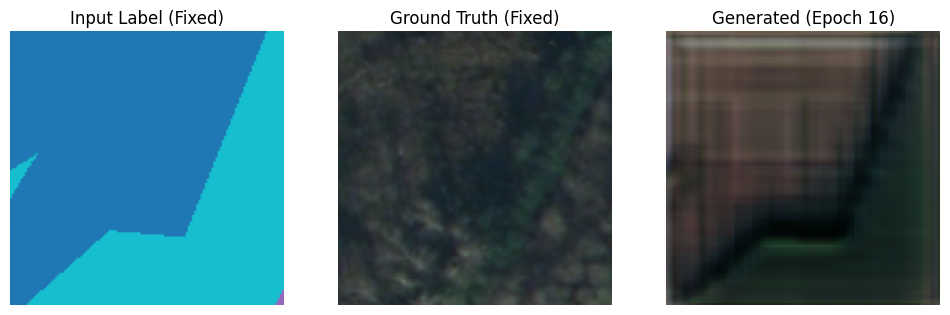

[Ep 17][Bt 0] D:-0.232 G:2.833 OT:0.302 T:89.8m
[Ep 17][Bt 20] D:-0.064 G:2.602 OT:0.253 T:90.5m
[Ep 17][Bt 40] D:-0.198 G:2.904 OT:0.345 T:91.2m
[Ep 17][Bt 60] D:-0.042 G:2.788 OT:0.362 T:91.8m
[Ep 17][Bt 80] D:-0.038 G:2.889 OT:0.354 T:92.5m
[Ep 17][Bt 100] D:-0.299 G:2.901 OT:0.320 T:93.2m
[Ep 17][Bt 120] D:-0.159 G:2.865 OT:0.350 T:93.9m
[Ep 17][Bt 140] D:-0.176 G:2.852 OT:0.319 T:94.5m


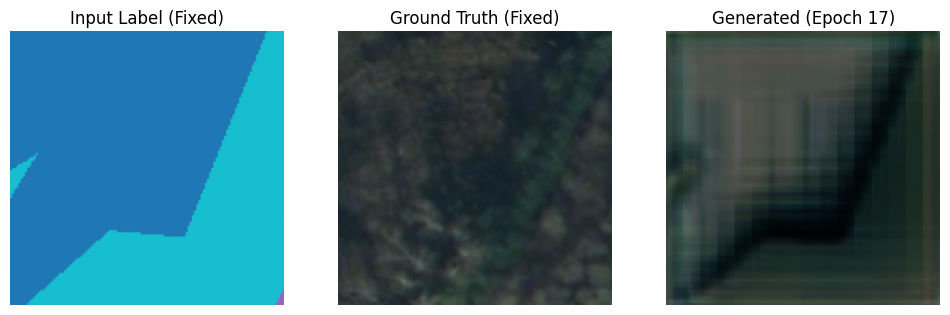

[Ep 18][Bt 0] D:-0.140 G:2.758 OT:0.268 T:95.2m
[Ep 18][Bt 20] D:0.108 G:2.738 OT:0.343 T:95.9m
[Ep 18][Bt 40] D:-0.121 G:2.711 OT:0.282 T:96.5m
[Ep 18][Bt 60] D:-0.227 G:2.831 OT:0.298 T:97.2m
[Ep 18][Bt 80] D:-0.257 G:2.988 OT:0.334 T:97.9m
[Ep 18][Bt 100] D:-0.149 G:2.836 OT:0.319 T:98.5m
[Ep 18][Bt 120] D:-0.119 G:2.861 OT:0.321 T:99.2m
[Ep 18][Bt 140] D:-0.095 G:2.740 OT:0.324 T:99.9m


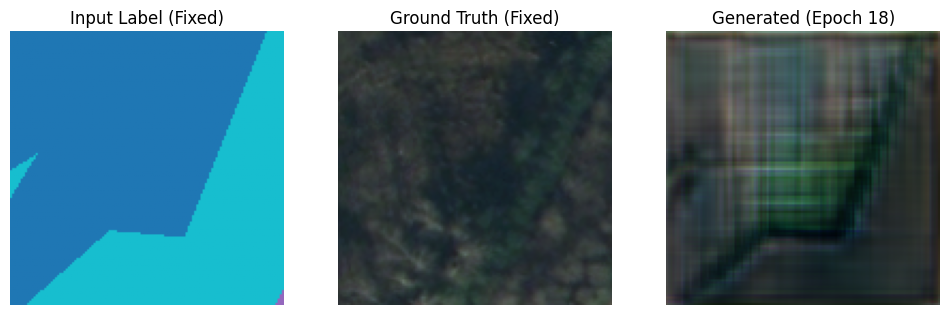

[Ep 19][Bt 0] D:-0.279 G:3.117 OT:0.390 T:100.5m
[Ep 19][Bt 20] D:-0.367 G:3.203 OT:0.399 T:101.2m
[Ep 19][Bt 40] D:-0.025 G:2.817 OT:0.275 T:101.8m
[Ep 19][Bt 60] D:-0.151 G:2.828 OT:0.292 T:102.5m
[Ep 19][Bt 80] D:-0.186 G:3.027 OT:0.331 T:103.2m
[Ep 19][Bt 100] D:-0.107 G:2.877 OT:0.310 T:103.9m
[Ep 19][Bt 120] D:-0.083 G:2.768 OT:0.316 T:104.5m
[Ep 19][Bt 140] D:-0.151 G:2.957 OT:0.309 T:105.2m


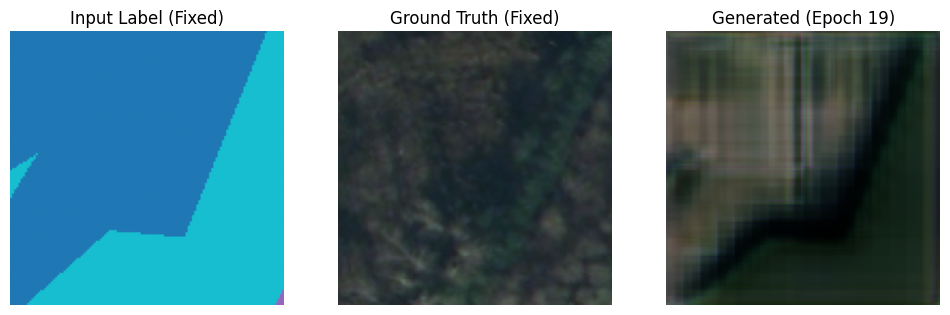

[Ep 20][Bt 0] D:-0.103 G:2.718 OT:0.309 T:105.8m
[Ep 20][Bt 20] D:-0.148 G:2.877 OT:0.332 T:106.5m
[Ep 20][Bt 40] D:-0.292 G:2.847 OT:0.265 T:107.1m
[Ep 20][Bt 60] D:-0.080 G:2.877 OT:0.309 T:107.8m
[Ep 20][Bt 80] D:-0.067 G:2.915 OT:0.324 T:108.5m
[Ep 20][Bt 100] D:-0.149 G:3.096 OT:0.395 T:109.2m
[Ep 20][Bt 120] D:-0.067 G:2.840 OT:0.290 T:109.9m
[Ep 20][Bt 140] D:0.009 G:2.857 OT:0.271 T:110.6m


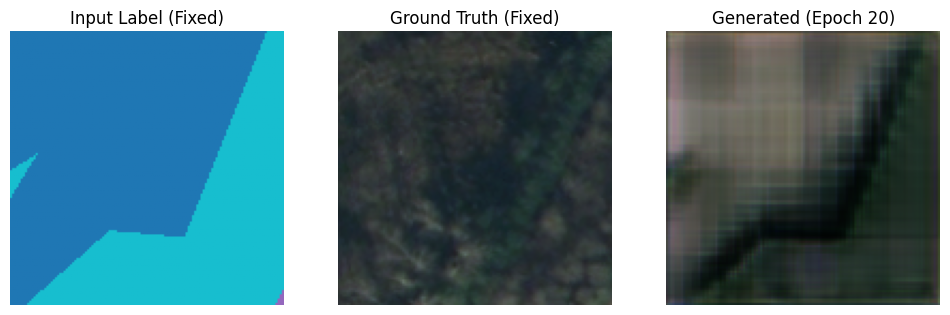

[Ep 21][Bt 0] D:-0.190 G:2.870 OT:0.299 T:111.2m
[Ep 21][Bt 20] D:-0.244 G:3.200 OT:0.370 T:111.9m
[Ep 21][Bt 40] D:-0.136 G:2.926 OT:0.365 T:112.6m
[Ep 21][Bt 60] D:-0.246 G:3.070 OT:0.315 T:113.3m
[Ep 21][Bt 80] D:-0.165 G:2.761 OT:0.264 T:114.0m
[Ep 21][Bt 100] D:0.023 G:2.793 OT:0.285 T:114.7m
[Ep 21][Bt 120] D:-0.185 G:2.785 OT:0.280 T:115.4m
[Ep 21][Bt 140] D:-0.048 G:2.752 OT:0.211 T:116.1m


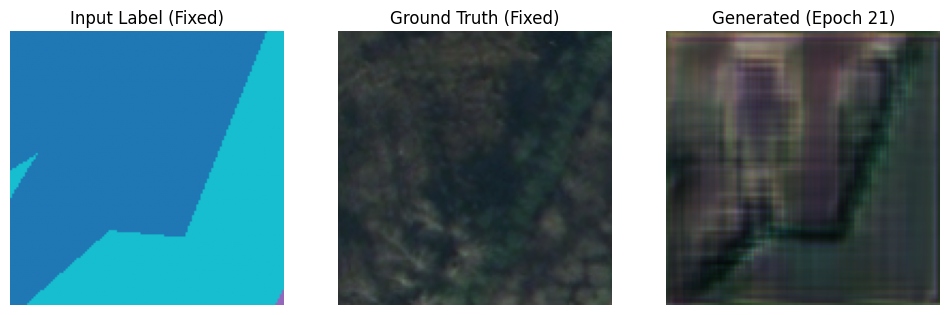

[Ep 22][Bt 0] D:-0.161 G:2.840 OT:0.329 T:116.8m
[Ep 22][Bt 20] D:-0.230 G:2.931 OT:0.326 T:117.5m
[Ep 22][Bt 40] D:0.010 G:2.545 OT:0.243 T:118.2m
[Ep 22][Bt 60] D:-0.177 G:3.006 OT:0.325 T:118.9m
[Ep 22][Bt 80] D:-0.077 G:2.615 OT:0.246 T:119.6m
[Ep 22][Bt 100] D:-0.054 G:2.789 OT:0.271 T:120.3m
[Ep 22][Bt 120] D:-0.238 G:2.925 OT:0.372 T:121.0m
[Ep 22][Bt 140] D:-0.056 G:2.937 OT:0.273 T:121.7m


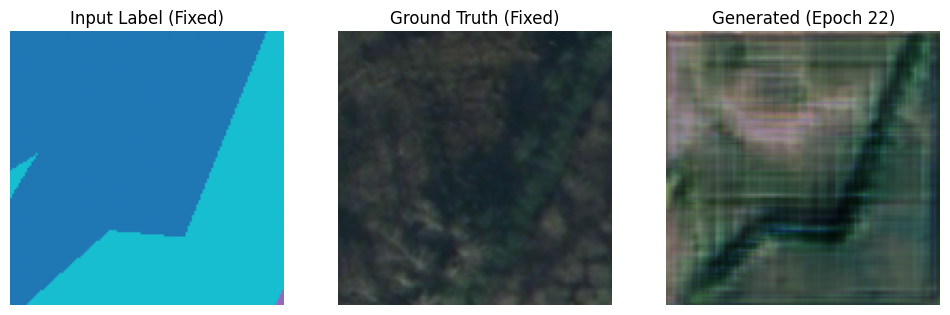

[Ep 23][Bt 0] D:-0.104 G:2.746 OT:0.272 T:122.3m
[Ep 23][Bt 20] D:-0.146 G:2.889 OT:0.287 T:123.0m
[Ep 23][Bt 40] D:-0.151 G:2.648 OT:0.263 T:123.7m
[Ep 23][Bt 60] D:-0.159 G:2.878 OT:0.306 T:124.4m
[Ep 23][Bt 80] D:-0.101 G:2.913 OT:0.382 T:125.1m
[Ep 23][Bt 100] D:0.027 G:2.738 OT:0.273 T:125.8m
[Ep 23][Bt 120] D:-0.122 G:2.749 OT:0.253 T:126.5m
[Ep 23][Bt 140] D:-0.159 G:2.983 OT:0.270 T:127.2m


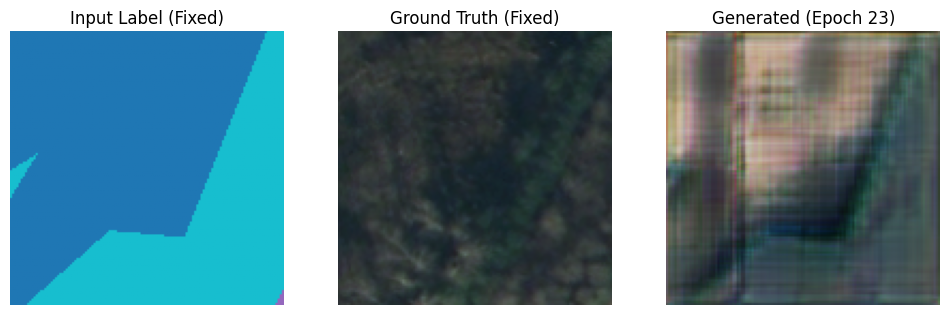

[Ep 24][Bt 0] D:-0.030 G:2.703 OT:0.272 T:127.8m
[Ep 24][Bt 20] D:-0.038 G:2.900 OT:0.289 T:128.5m
[Ep 24][Bt 40] D:-0.046 G:2.508 OT:0.210 T:129.2m
[Ep 24][Bt 60] D:0.112 G:2.758 OT:0.301 T:129.9m
[Ep 24][Bt 80] D:-0.204 G:2.756 OT:0.314 T:130.6m
[Ep 24][Bt 100] D:-0.122 G:2.832 OT:0.300 T:131.3m
[Ep 24][Bt 120] D:-0.008 G:2.797 OT:0.267 T:132.0m
[Ep 24][Bt 140] D:0.073 G:2.594 OT:0.279 T:132.7m


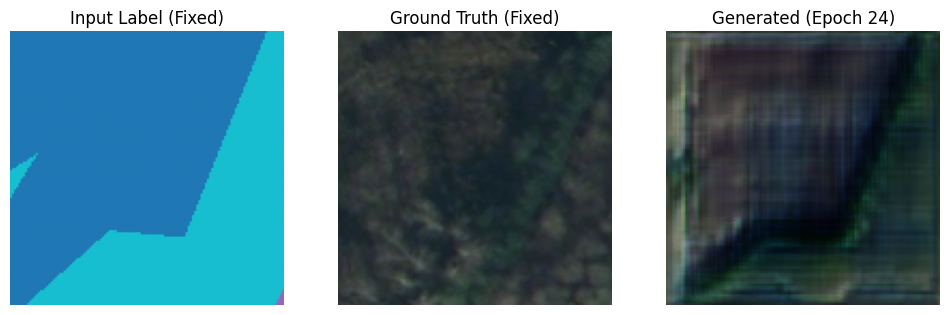

[Ep 25][Bt 0] D:-0.058 G:2.802 OT:0.266 T:133.4m
[Ep 25][Bt 20] D:-0.091 G:2.594 OT:0.243 T:134.1m
[Ep 25][Bt 40] D:-0.312 G:3.060 OT:0.300 T:134.8m
[Ep 25][Bt 60] D:-0.106 G:2.615 OT:0.239 T:135.5m
[Ep 25][Bt 80] D:-0.047 G:2.800 OT:0.235 T:136.2m
[Ep 25][Bt 100] D:-0.159 G:2.936 OT:0.314 T:136.9m
[Ep 25][Bt 120] D:-0.197 G:2.789 OT:0.294 T:137.6m
[Ep 25][Bt 140] D:-0.216 G:2.896 OT:0.256 T:138.3m


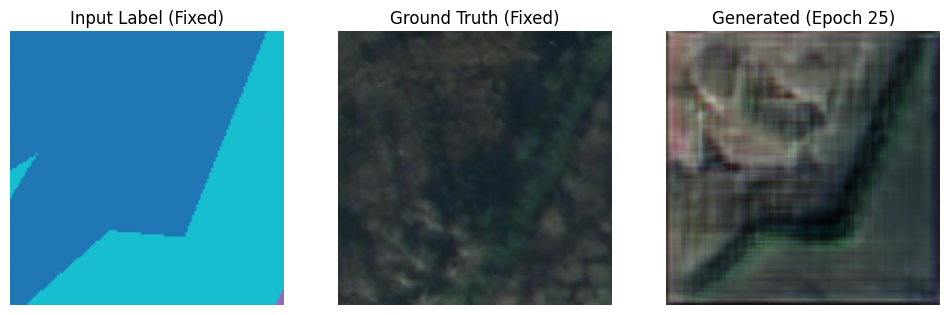

[Ep 26][Bt 0] D:-0.120 G:2.830 OT:0.297 T:138.9m
[Ep 26][Bt 20] D:-0.047 G:2.814 OT:0.307 T:139.5m
[Ep 26][Bt 40] D:-0.134 G:2.972 OT:0.308 T:140.1m
[Ep 26][Bt 60] D:-0.018 G:2.599 OT:0.221 T:140.8m
[Ep 26][Bt 80] D:-0.032 G:2.766 OT:0.244 T:141.5m
[Ep 26][Bt 100] D:-0.104 G:2.674 OT:0.236 T:142.1m
[Ep 26][Bt 120] D:-0.076 G:2.866 OT:0.298 T:142.8m
[Ep 26][Bt 140] D:-0.113 G:2.824 OT:0.215 T:143.4m


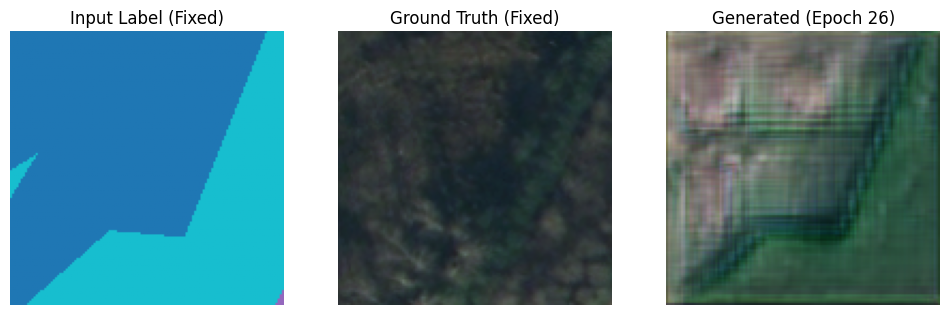

[Ep 27][Bt 0] D:-0.004 G:2.718 OT:0.231 T:144.0m
[Ep 27][Bt 20] D:-0.099 G:2.916 OT:0.276 T:144.6m
[Ep 27][Bt 40] D:-0.164 G:2.905 OT:0.331 T:145.3m
[Ep 27][Bt 60] D:-0.235 G:2.863 OT:0.224 T:145.9m
[Ep 27][Bt 80] D:0.007 G:2.633 OT:0.235 T:146.6m
[Ep 27][Bt 100] D:-0.117 G:2.954 OT:0.293 T:147.2m
[Ep 27][Bt 120] D:0.007 G:2.916 OT:0.310 T:147.9m
[Ep 27][Bt 140] D:-0.231 G:3.107 OT:0.323 T:148.5m


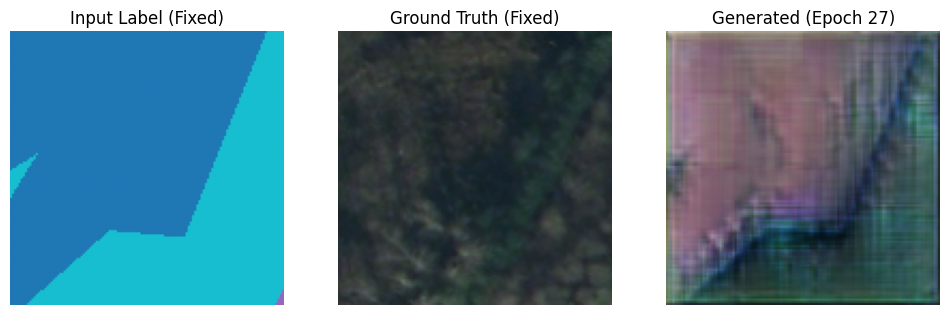

[Ep 28][Bt 0] D:-0.013 G:2.679 OT:0.219 T:149.1m
[Ep 28][Bt 20] D:0.017 G:2.685 OT:0.250 T:149.7m
[Ep 28][Bt 40] D:0.094 G:2.814 OT:0.219 T:150.4m
[Ep 28][Bt 60] D:0.017 G:2.349 OT:0.200 T:151.1m
[Ep 28][Bt 80] D:-0.018 G:2.884 OT:0.271 T:151.7m
[Ep 28][Bt 100] D:-0.278 G:2.860 OT:0.338 T:152.4m
[Ep 28][Bt 120] D:-0.144 G:3.003 OT:0.305 T:153.0m
[Ep 28][Bt 140] D:-0.131 G:2.713 OT:0.233 T:153.7m


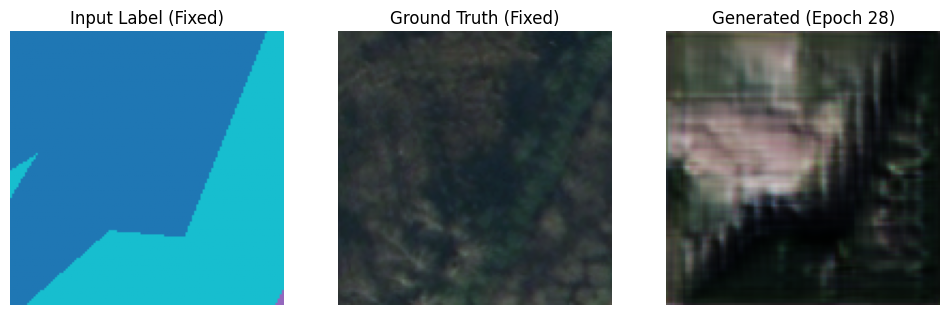

[Ep 29][Bt 0] D:0.073 G:2.815 OT:0.313 T:154.2m
[Ep 29][Bt 20] D:-0.126 G:2.623 OT:0.205 T:154.9m
[Ep 29][Bt 40] D:-0.188 G:2.883 OT:0.255 T:155.5m
[Ep 29][Bt 60] D:-0.072 G:2.773 OT:0.205 T:156.2m
[Ep 29][Bt 80] D:-0.107 G:2.943 OT:0.266 T:156.8m
[Ep 29][Bt 100] D:0.102 G:2.837 OT:0.290 T:157.5m
[Ep 29][Bt 120] D:-0.144 G:2.901 OT:0.232 T:158.1m
[Ep 29][Bt 140] D:-0.205 G:3.020 OT:0.287 T:158.7m


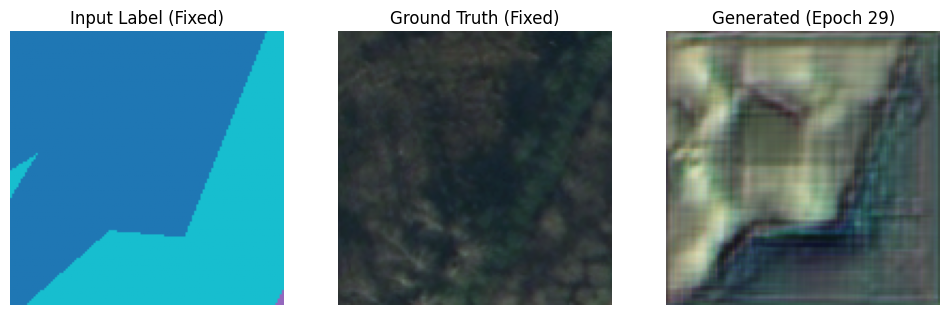

[Ep 30][Bt 0] D:-0.069 G:2.702 OT:0.237 T:159.3m
[Ep 30][Bt 20] D:0.002 G:2.759 OT:0.274 T:160.0m
[Ep 30][Bt 40] D:0.033 G:2.784 OT:0.282 T:160.6m
[Ep 30][Bt 60] D:-0.072 G:2.737 OT:0.213 T:161.3m
[Ep 30][Bt 80] D:-0.064 G:2.791 OT:0.274 T:161.9m
[Ep 30][Bt 100] D:0.026 G:2.885 OT:0.288 T:162.6m
[Ep 30][Bt 120] D:0.004 G:2.515 OT:0.181 T:163.2m
[Ep 30][Bt 140] D:-0.079 G:2.660 OT:0.248 T:163.8m


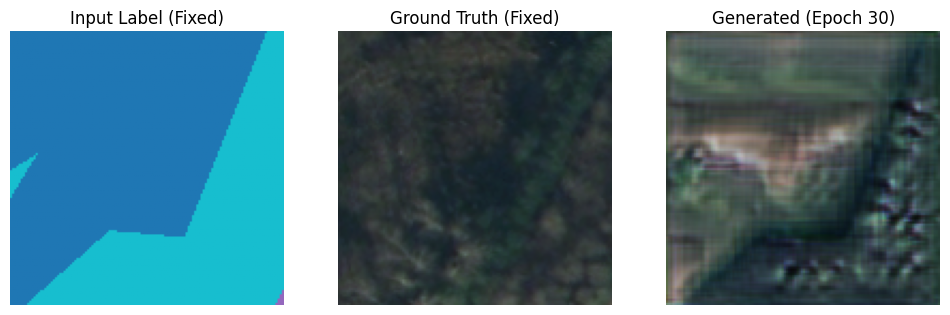

[Ep 31][Bt 0] D:0.058 G:2.647 OT:0.197 T:164.4m
[Ep 31][Bt 20] D:-0.084 G:2.848 OT:0.328 T:165.1m
[Ep 31][Bt 40] D:-0.033 G:2.891 OT:0.219 T:165.7m
[Ep 31][Bt 60] D:-0.052 G:2.677 OT:0.235 T:166.4m
[Ep 31][Bt 80] D:-0.112 G:2.855 OT:0.301 T:167.1m
[Ep 31][Bt 100] D:-0.050 G:2.673 OT:0.259 T:167.7m
[Ep 31][Bt 120] D:-0.042 G:2.652 OT:0.183 T:168.4m
[Ep 31][Bt 140] D:-0.008 G:2.741 OT:0.241 T:169.0m


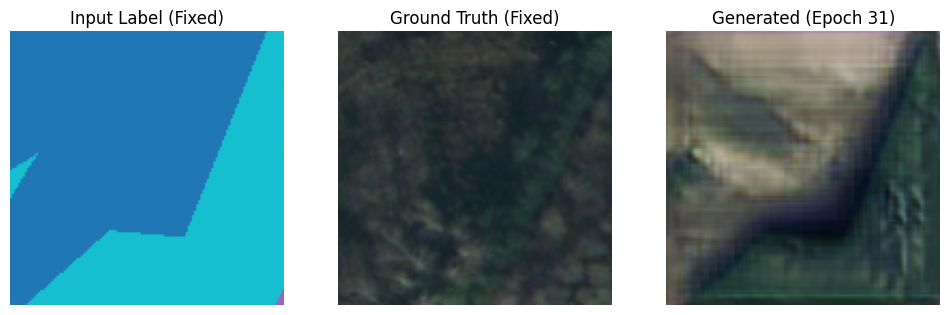

[Ep 32][Bt 0] D:-0.088 G:2.533 OT:0.229 T:169.6m
[Ep 32][Bt 20] D:-0.129 G:2.814 OT:0.274 T:170.2m
[Ep 32][Bt 40] D:-0.330 G:2.873 OT:0.313 T:170.9m
[Ep 32][Bt 60] D:-0.210 G:2.881 OT:0.226 T:171.6m
[Ep 32][Bt 80] D:-0.056 G:2.729 OT:0.240 T:172.2m
[Ep 32][Bt 100] D:-0.188 G:2.566 OT:0.268 T:172.9m
[Ep 32][Bt 120] D:-0.044 G:2.740 OT:0.213 T:173.5m
[Ep 32][Bt 140] D:-0.120 G:2.713 OT:0.265 T:174.2m


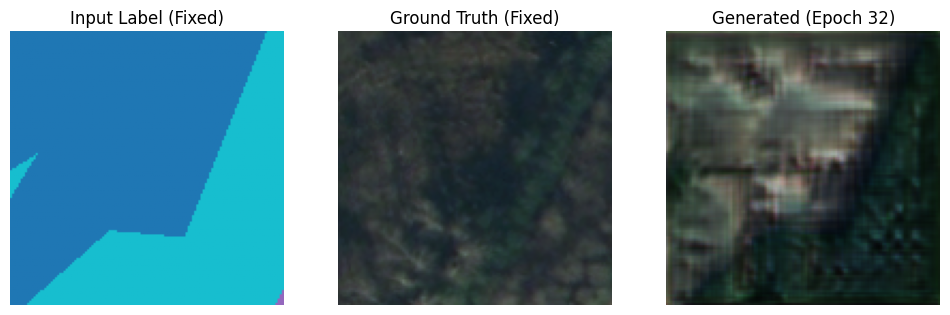

[Ep 33][Bt 0] D:-0.099 G:2.687 OT:0.249 T:174.8m
[Ep 33][Bt 20] D:-0.114 G:2.778 OT:0.241 T:175.4m
[Ep 33][Bt 40] D:-0.143 G:2.934 OT:0.274 T:176.1m
[Ep 33][Bt 60] D:-0.107 G:2.626 OT:0.205 T:176.7m
[Ep 33][Bt 80] D:0.121 G:2.652 OT:0.256 T:177.4m
[Ep 33][Bt 100] D:-0.086 G:2.645 OT:0.208 T:178.0m
[Ep 33][Bt 120] D:-0.214 G:2.814 OT:0.247 T:178.7m
[Ep 33][Bt 140] D:-0.169 G:2.814 OT:0.245 T:179.4m


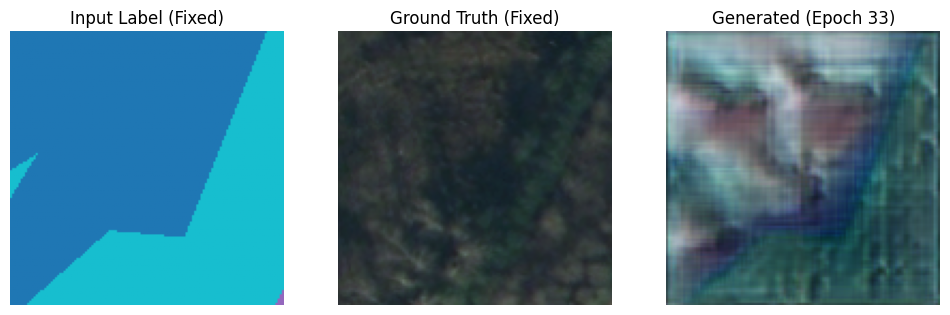

[Ep 34][Bt 0] D:0.046 G:2.589 OT:0.244 T:180.1m
[Ep 34][Bt 20] D:-0.159 G:2.867 OT:0.214 T:180.8m
[Ep 34][Bt 40] D:-0.059 G:2.815 OT:0.258 T:181.4m
[Ep 34][Bt 60] D:-0.100 G:2.670 OT:0.224 T:182.1m
[Ep 34][Bt 80] D:-0.030 G:2.783 OT:0.244 T:182.8m
[Ep 34][Bt 100] D:-0.138 G:2.884 OT:0.283 T:183.4m
[Ep 34][Bt 120] D:0.098 G:2.736 OT:0.178 T:184.1m
[Ep 34][Bt 140] D:-0.140 G:2.638 OT:0.224 T:184.7m


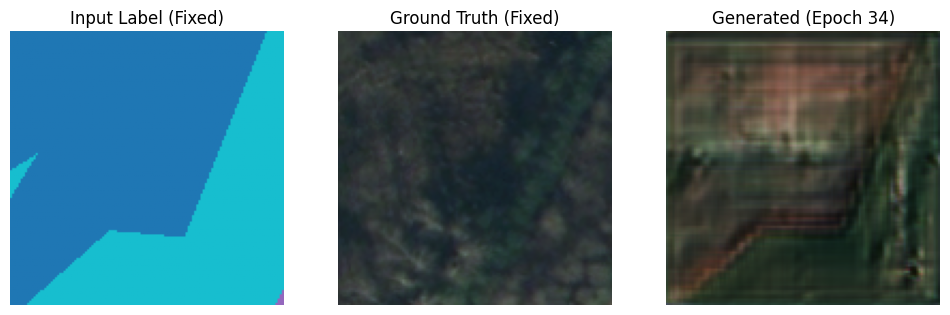

[Ep 35][Bt 0] D:0.097 G:2.682 OT:0.243 T:185.3m
[Ep 35][Bt 20] D:0.056 G:2.521 OT:0.265 T:186.0m
[Ep 35][Bt 40] D:-0.095 G:2.732 OT:0.188 T:186.6m
[Ep 35][Bt 60] D:0.116 G:2.684 OT:0.215 T:187.2m
[Ep 35][Bt 80] D:-0.061 G:2.590 OT:0.172 T:187.9m
[Ep 35][Bt 100] D:-0.092 G:2.641 OT:0.237 T:188.5m
[Ep 35][Bt 120] D:-0.111 G:2.650 OT:0.208 T:189.2m
[Ep 35][Bt 140] D:0.077 G:2.574 OT:0.197 T:189.8m


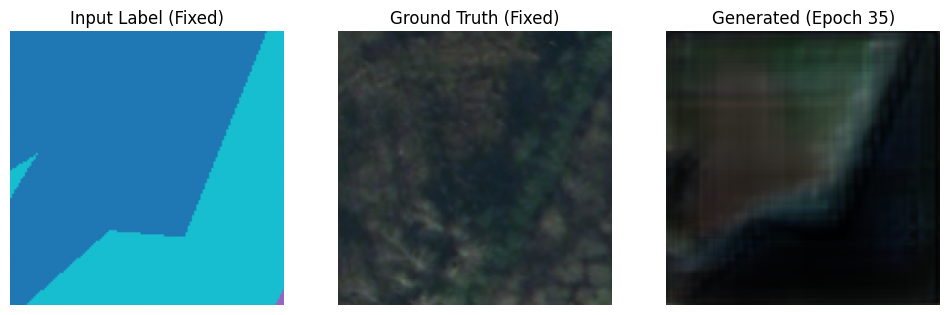

[Ep 36][Bt 0] D:-0.049 G:2.715 OT:0.212 T:190.4m
[Ep 36][Bt 20] D:0.028 G:2.572 OT:0.173 T:191.1m
[Ep 36][Bt 40] D:0.040 G:2.675 OT:0.187 T:191.7m
[Ep 36][Bt 60] D:-0.083 G:2.930 OT:0.266 T:192.3m
[Ep 36][Bt 80] D:-0.058 G:2.491 OT:0.182 T:193.0m
[Ep 36][Bt 100] D:0.047 G:2.814 OT:0.259 T:193.6m
[Ep 36][Bt 120] D:-0.004 G:2.401 OT:0.226 T:194.3m
[Ep 36][Bt 140] D:-0.004 G:2.701 OT:0.197 T:194.9m


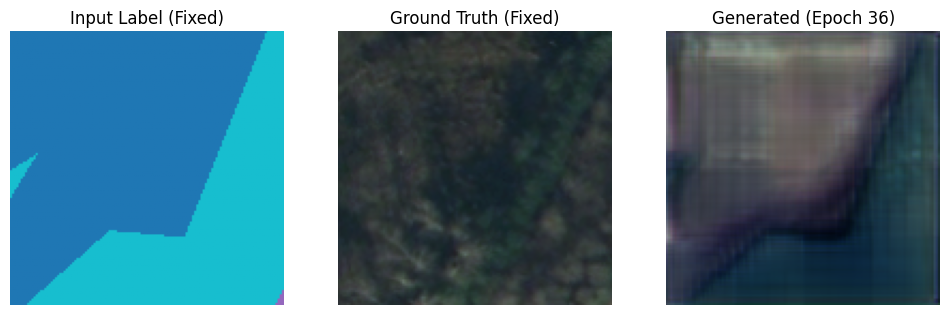

[Ep 37][Bt 0] D:0.061 G:2.631 OT:0.196 T:195.5m
[Ep 37][Bt 20] D:-0.006 G:2.581 OT:0.215 T:196.2m
[Ep 37][Bt 40] D:0.002 G:2.592 OT:0.216 T:196.8m
[Ep 37][Bt 60] D:-0.059 G:2.793 OT:0.244 T:197.4m
[Ep 37][Bt 80] D:-0.028 G:2.518 OT:0.143 T:198.1m
[Ep 37][Bt 100] D:-0.034 G:2.560 OT:0.179 T:198.7m
[Ep 37][Bt 120] D:0.154 G:2.588 OT:0.221 T:199.4m
[Ep 37][Bt 140] D:-0.218 G:2.559 OT:0.211 T:200.0m


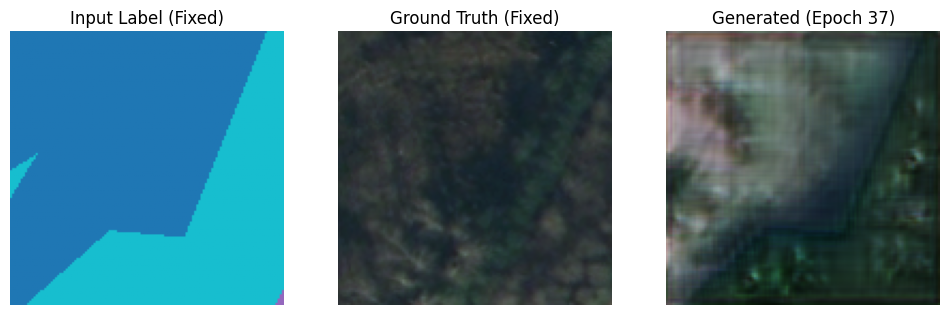

[Ep 38][Bt 0] D:0.029 G:2.572 OT:0.208 T:200.6m
[Ep 38][Bt 20] D:-0.003 G:2.437 OT:0.205 T:201.3m
[Ep 38][Bt 40] D:0.091 G:2.503 OT:0.198 T:201.9m
[Ep 38][Bt 60] D:-0.000 G:2.364 OT:0.139 T:202.6m
[Ep 38][Bt 80] D:0.004 G:2.600 OT:0.196 T:203.2m
[Ep 38][Bt 100] D:-0.054 G:2.245 OT:0.179 T:203.9m
[Ep 38][Bt 120] D:0.098 G:2.666 OT:0.226 T:204.6m
[Ep 38][Bt 140] D:-0.190 G:2.438 OT:0.161 T:205.2m


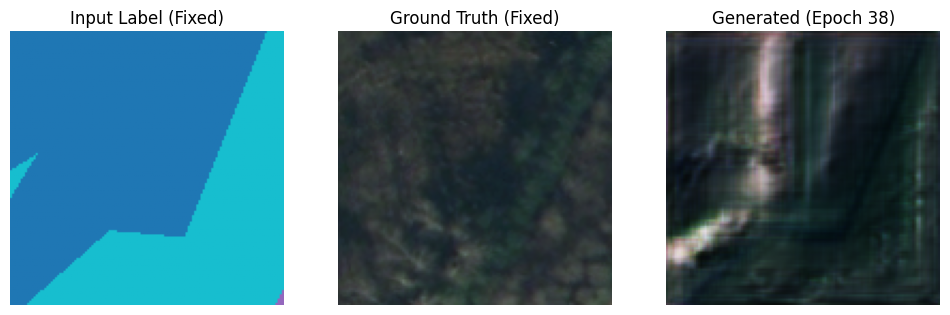

[Ep 39][Bt 0] D:0.084 G:2.581 OT:0.243 T:205.8m
[Ep 39][Bt 20] D:-0.018 G:2.490 OT:0.157 T:206.4m
[Ep 39][Bt 40] D:0.068 G:2.374 OT:0.190 T:207.1m
[Ep 39][Bt 60] D:-0.053 G:2.578 OT:0.202 T:207.7m
[Ep 39][Bt 80] D:-0.056 G:2.678 OT:0.227 T:208.4m
[Ep 39][Bt 100] D:-0.096 G:2.671 OT:0.153 T:209.0m
[Ep 39][Bt 120] D:-0.024 G:2.559 OT:0.191 T:209.6m
[Ep 39][Bt 140] D:-0.041 G:2.709 OT:0.175 T:210.3m


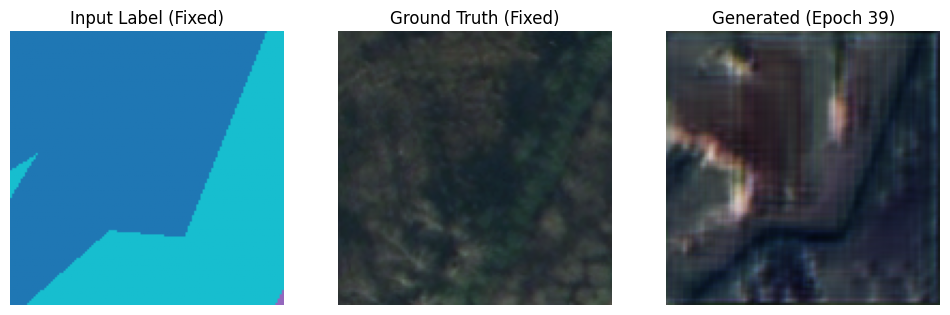

[Ep 40][Bt 0] D:0.002 G:2.395 OT:0.166 T:210.9m
[Ep 40][Bt 20] D:0.028 G:2.564 OT:0.204 T:211.6m
[Ep 40][Bt 40] D:-0.167 G:2.590 OT:0.212 T:212.2m
[Ep 40][Bt 60] D:0.059 G:2.659 OT:0.191 T:212.9m
[Ep 40][Bt 80] D:-0.084 G:2.527 OT:0.177 T:213.5m
[Ep 40][Bt 100] D:0.077 G:2.590 OT:0.180 T:214.1m
[Ep 40][Bt 120] D:-0.139 G:2.699 OT:0.191 T:214.8m
[Ep 40][Bt 140] D:-0.011 G:2.567 OT:0.154 T:215.4m


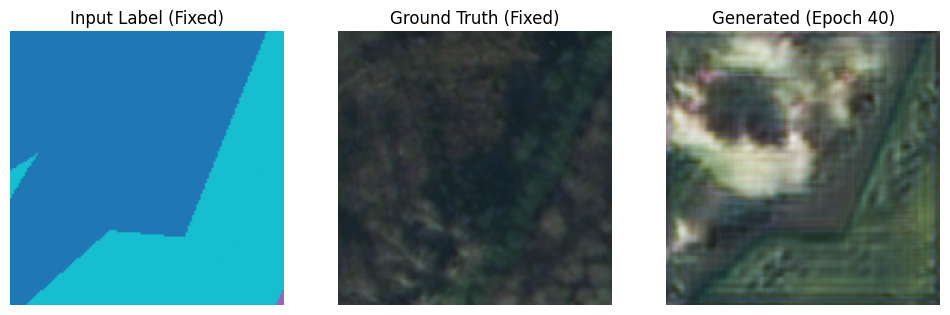

[Ep 41][Bt 0] D:0.006 G:2.690 OT:0.206 T:216.0m
[Ep 41][Bt 20] D:0.054 G:2.865 OT:0.191 T:216.7m
[Ep 41][Bt 40] D:-0.069 G:2.599 OT:0.242 T:217.3m
[Ep 41][Bt 60] D:0.172 G:2.607 OT:0.207 T:218.0m
[Ep 41][Bt 80] D:-0.049 G:2.134 OT:0.166 T:218.6m
[Ep 41][Bt 100] D:-0.029 G:2.523 OT:0.204 T:219.3m
[Ep 41][Bt 120] D:0.066 G:2.525 OT:0.224 T:219.9m
[Ep 41][Bt 140] D:0.063 G:2.522 OT:0.203 T:220.5m


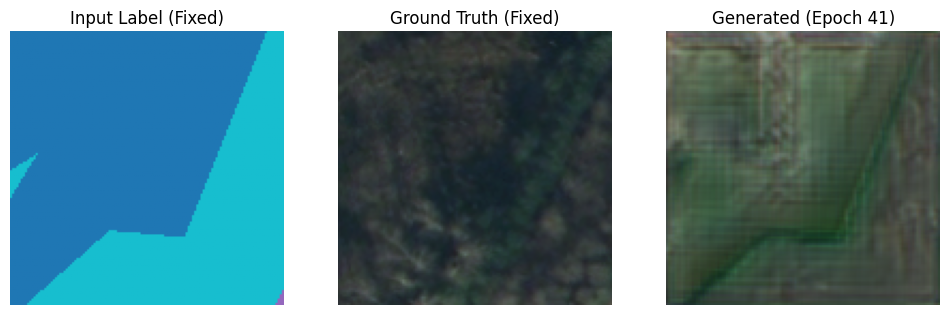

[Ep 42][Bt 0] D:-0.213 G:2.426 OT:0.145 T:221.1m
[Ep 42][Bt 20] D:0.023 G:2.699 OT:0.230 T:221.8m
[Ep 42][Bt 40] D:-0.236 G:2.531 OT:0.174 T:222.4m
[Ep 42][Bt 60] D:-0.127 G:2.722 OT:0.150 T:223.0m
[Ep 42][Bt 80] D:-0.016 G:2.358 OT:0.157 T:223.7m
[Ep 42][Bt 100] D:0.302 G:2.570 OT:0.256 T:224.3m
[Ep 42][Bt 120] D:-0.205 G:2.736 OT:0.191 T:225.0m
[Ep 42][Bt 140] D:-0.106 G:2.792 OT:0.217 T:225.6m


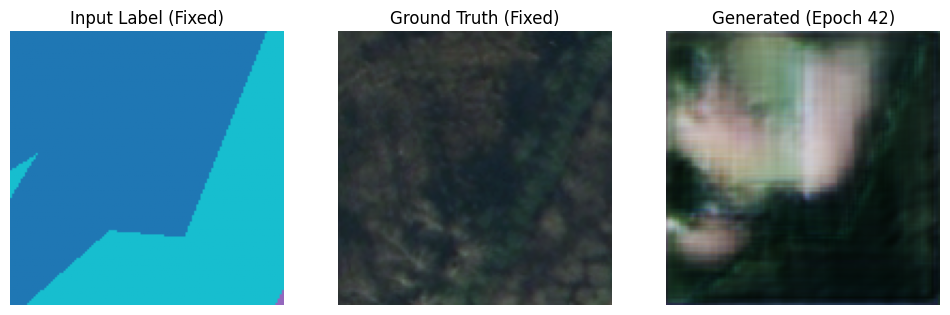

[Ep 43][Bt 0] D:0.103 G:2.539 OT:0.260 T:226.2m
[Ep 43][Bt 20] D:0.009 G:2.652 OT:0.227 T:226.8m
[Ep 43][Bt 40] D:0.034 G:2.509 OT:0.184 T:227.5m
[Ep 43][Bt 60] D:0.143 G:2.319 OT:0.173 T:228.1m
[Ep 43][Bt 80] D:-0.082 G:2.669 OT:0.190 T:228.8m
[Ep 43][Bt 100] D:0.016 G:2.395 OT:0.165 T:229.4m
[Ep 43][Bt 120] D:0.085 G:2.580 OT:0.204 T:230.0m
[Ep 43][Bt 140] D:-0.098 G:2.287 OT:0.172 T:230.7m


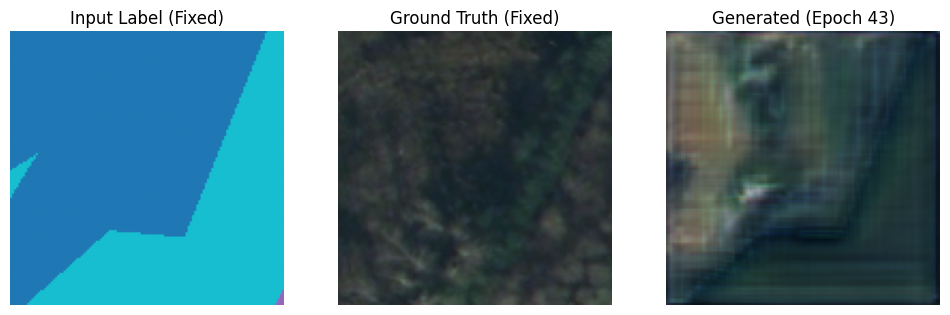

[Ep 44][Bt 0] D:0.045 G:2.498 OT:0.149 T:231.3m
[Ep 44][Bt 20] D:-0.062 G:2.342 OT:0.147 T:231.9m
[Ep 44][Bt 40] D:0.017 G:2.586 OT:0.180 T:232.6m
[Ep 44][Bt 60] D:0.063 G:2.579 OT:0.187 T:233.2m
[Ep 44][Bt 80] D:0.068 G:2.574 OT:0.187 T:233.9m
[Ep 44][Bt 100] D:0.024 G:2.502 OT:0.143 T:234.5m
[Ep 44][Bt 120] D:0.041 G:2.459 OT:0.150 T:235.1m
[Ep 44][Bt 140] D:0.163 G:2.454 OT:0.195 T:235.8m


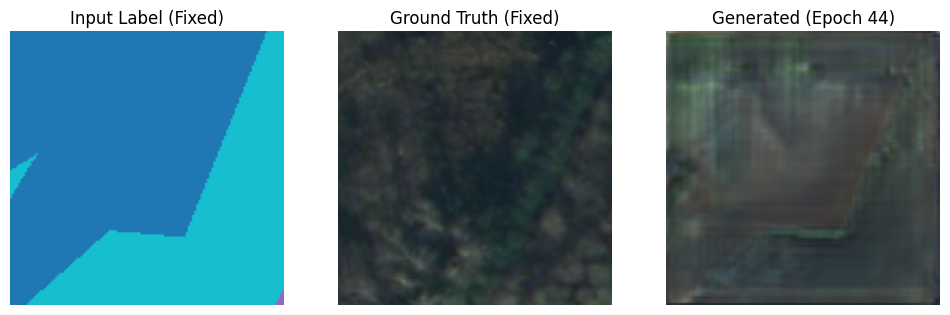

[Ep 45][Bt 0] D:-0.047 G:2.424 OT:0.161 T:236.3m
[Ep 45][Bt 20] D:-0.014 G:2.795 OT:0.242 T:237.0m
[Ep 45][Bt 40] D:-0.104 G:2.756 OT:0.193 T:237.6m
[Ep 45][Bt 60] D:-0.143 G:2.637 OT:0.160 T:238.3m
[Ep 45][Bt 80] D:-0.079 G:2.587 OT:0.175 T:238.9m
[Ep 45][Bt 100] D:0.137 G:2.816 OT:0.262 T:239.6m
[Ep 45][Bt 120] D:-0.061 G:2.514 OT:0.126 T:240.2m
[Ep 45][Bt 140] D:0.082 G:2.605 OT:0.187 T:240.9m


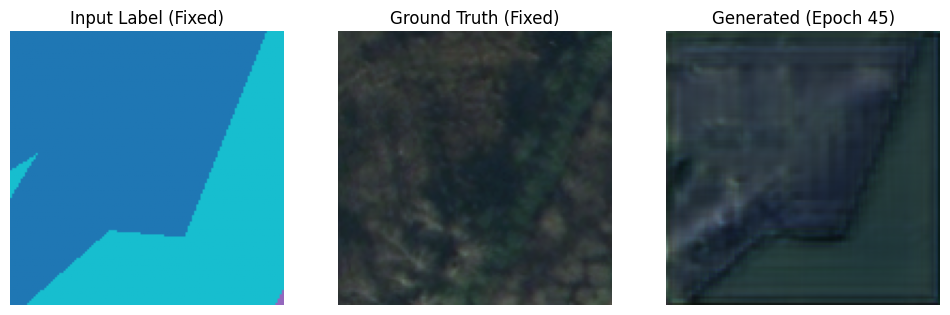

[Ep 46][Bt 0] D:-0.086 G:2.408 OT:0.141 T:241.4m
[Ep 46][Bt 20] D:0.299 G:2.520 OT:0.235 T:242.1m
[Ep 46][Bt 40] D:-0.052 G:2.348 OT:0.142 T:242.8m
[Ep 46][Bt 60] D:0.010 G:2.504 OT:0.166 T:243.4m
[Ep 46][Bt 80] D:-0.098 G:2.539 OT:0.197 T:244.0m
[Ep 46][Bt 100] D:-0.043 G:2.611 OT:0.209 T:244.7m
[Ep 46][Bt 120] D:-0.193 G:2.493 OT:0.167 T:245.3m
[Ep 46][Bt 140] D:0.010 G:2.155 OT:0.153 T:246.0m


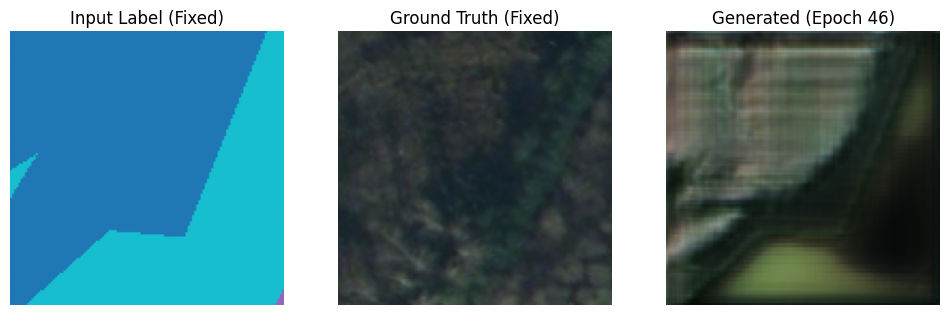

[Ep 47][Bt 0] D:-0.008 G:2.654 OT:0.255 T:246.6m
[Ep 47][Bt 20] D:-0.036 G:2.447 OT:0.165 T:247.2m
[Ep 47][Bt 40] D:-0.061 G:2.438 OT:0.188 T:247.8m
[Ep 47][Bt 60] D:0.101 G:2.483 OT:0.236 T:248.5m
[Ep 47][Bt 80] D:0.047 G:2.495 OT:0.196 T:249.1m
[Ep 47][Bt 100] D:-0.034 G:2.349 OT:0.146 T:249.8m
[Ep 47][Bt 120] D:-0.119 G:2.143 OT:0.141 T:250.4m
[Ep 47][Bt 140] D:0.044 G:2.409 OT:0.176 T:251.1m


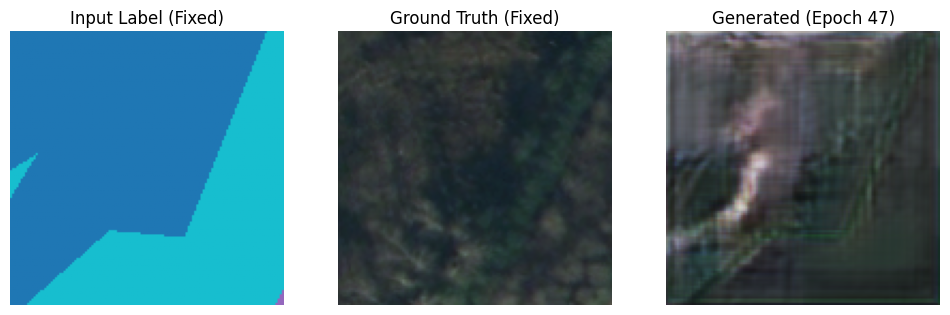

[Ep 48][Bt 0] D:-0.017 G:2.274 OT:0.161 T:251.7m
[Ep 48][Bt 20] D:-0.025 G:2.246 OT:0.209 T:252.3m
[Ep 48][Bt 40] D:-0.066 G:2.103 OT:0.184 T:253.0m
[Ep 48][Bt 60] D:-0.013 G:2.383 OT:0.182 T:253.7m
[Ep 48][Bt 80] D:-0.044 G:2.203 OT:0.166 T:254.3m
[Ep 48][Bt 100] D:0.131 G:2.645 OT:0.220 T:255.0m
[Ep 48][Bt 120] D:-0.044 G:2.447 OT:0.165 T:255.6m
[Ep 48][Bt 140] D:-0.037 G:2.556 OT:0.167 T:256.3m


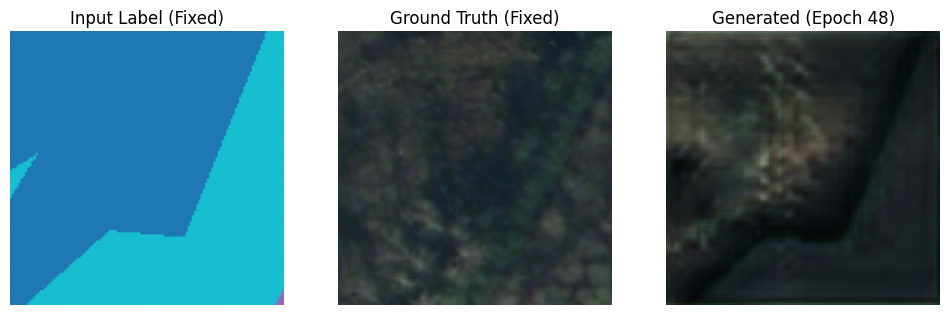

[Ep 49][Bt 0] D:-0.078 G:2.243 OT:0.145 T:256.9m
[Ep 49][Bt 20] D:-0.079 G:2.454 OT:0.191 T:257.5m
[Ep 49][Bt 40] D:0.015 G:2.679 OT:0.249 T:258.2m
[Ep 49][Bt 60] D:0.013 G:2.649 OT:0.203 T:258.8m
[Ep 49][Bt 80] D:-0.048 G:2.451 OT:0.181 T:259.5m
[Ep 49][Bt 100] D:-0.024 G:2.753 OT:0.231 T:260.2m
[Ep 49][Bt 120] D:0.013 G:2.585 OT:0.186 T:260.8m
[Ep 49][Bt 140] D:0.030 G:2.513 OT:0.208 T:261.5m


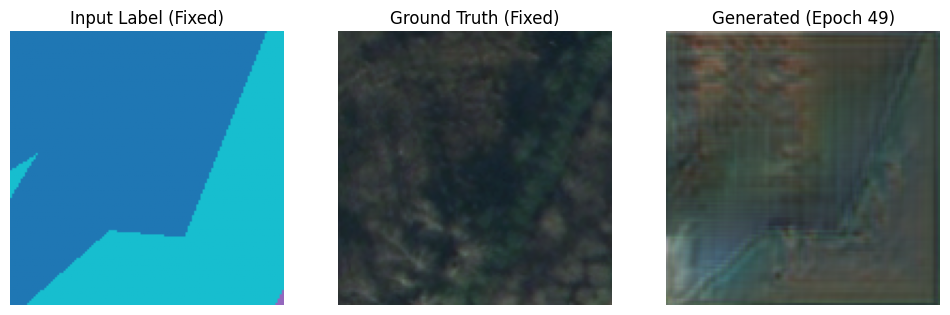

[Ep 50][Bt 0] D:-0.149 G:2.472 OT:0.171 T:262.1m
[Ep 50][Bt 20] D:0.178 G:2.428 OT:0.187 T:262.7m
[Ep 50][Bt 40] D:-0.011 G:2.393 OT:0.149 T:263.4m
[Ep 50][Bt 60] D:0.122 G:2.568 OT:0.185 T:264.0m
[Ep 50][Bt 80] D:0.090 G:2.672 OT:0.155 T:264.7m
[Ep 50][Bt 100] D:-0.011 G:2.469 OT:0.105 T:265.3m
[Ep 50][Bt 120] D:0.054 G:2.690 OT:0.190 T:265.9m
[Ep 50][Bt 140] D:-0.004 G:2.476 OT:0.147 T:266.6m


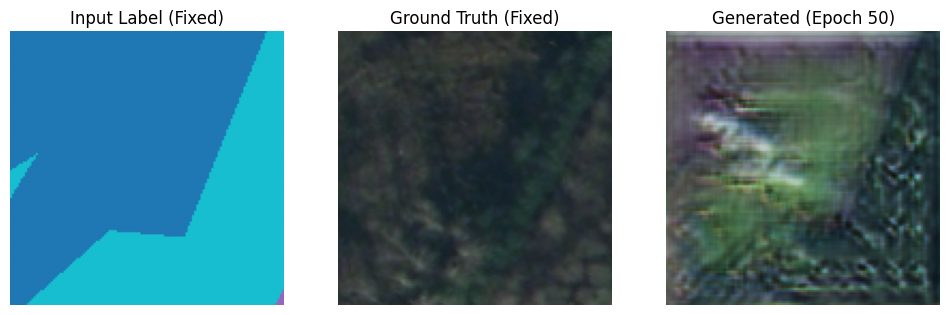

[Ep 51][Bt 0] D:0.055 G:2.535 OT:0.140 T:267.2m
[Ep 51][Bt 20] D:0.029 G:2.393 OT:0.143 T:267.8m
[Ep 51][Bt 40] D:-0.010 G:2.589 OT:0.183 T:268.5m
[Ep 51][Bt 60] D:-0.033 G:2.549 OT:0.165 T:269.1m
[Ep 51][Bt 80] D:-0.101 G:2.518 OT:0.146 T:269.8m
[Ep 51][Bt 100] D:-0.128 G:2.400 OT:0.116 T:270.4m
[Ep 51][Bt 120] D:-0.110 G:2.310 OT:0.142 T:271.1m
[Ep 51][Bt 140] D:-0.066 G:2.522 OT:0.128 T:271.7m


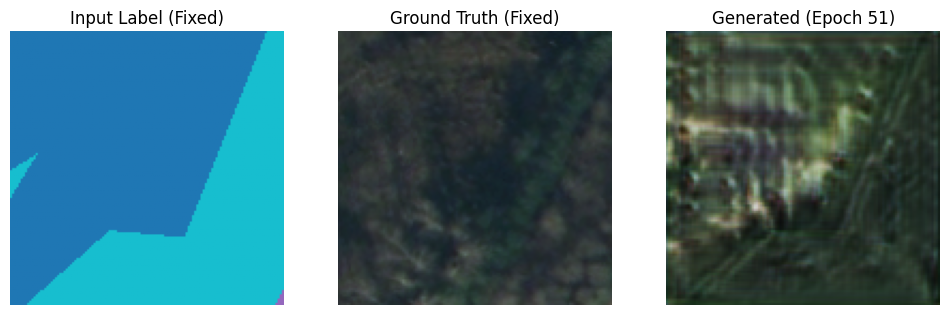

[Ep 52][Bt 0] D:0.137 G:2.369 OT:0.155 T:272.3m
[Ep 52][Bt 20] D:0.080 G:2.445 OT:0.145 T:273.0m
[Ep 52][Bt 40] D:-0.212 G:2.454 OT:0.162 T:273.7m
[Ep 52][Bt 60] D:0.214 G:2.570 OT:0.202 T:274.3m
[Ep 52][Bt 80] D:-0.013 G:2.284 OT:0.133 T:275.0m
[Ep 52][Bt 100] D:-0.028 G:2.523 OT:0.160 T:275.6m
[Ep 52][Bt 120] D:-0.102 G:2.565 OT:0.198 T:276.3m
[Ep 52][Bt 140] D:-0.052 G:2.515 OT:0.168 T:276.9m


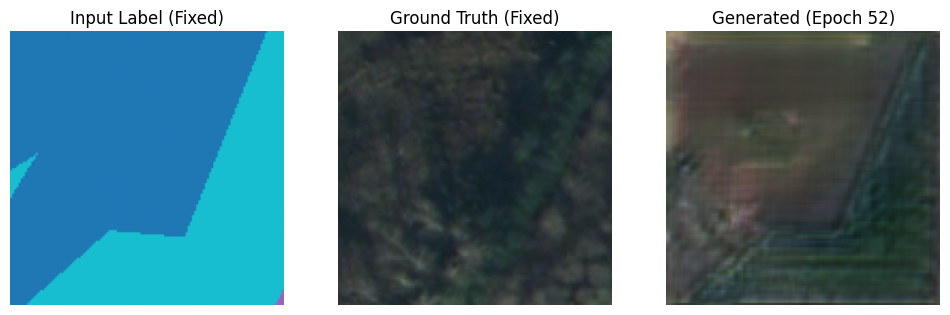

[Ep 53][Bt 0] D:-0.081 G:2.410 OT:0.138 T:277.5m
[Ep 53][Bt 20] D:0.007 G:2.284 OT:0.129 T:278.2m
[Ep 53][Bt 40] D:-0.118 G:2.396 OT:0.171 T:278.8m
[Ep 53][Bt 60] D:0.019 G:2.342 OT:0.135 T:279.5m
[Ep 53][Bt 80] D:-0.104 G:2.282 OT:0.155 T:280.1m
[Ep 53][Bt 100] D:-0.095 G:2.503 OT:0.165 T:280.7m
[Ep 53][Bt 120] D:-0.052 G:2.263 OT:0.113 T:296.3m
[Ep 53][Bt 140] D:-0.015 G:2.314 OT:0.150 T:296.9m


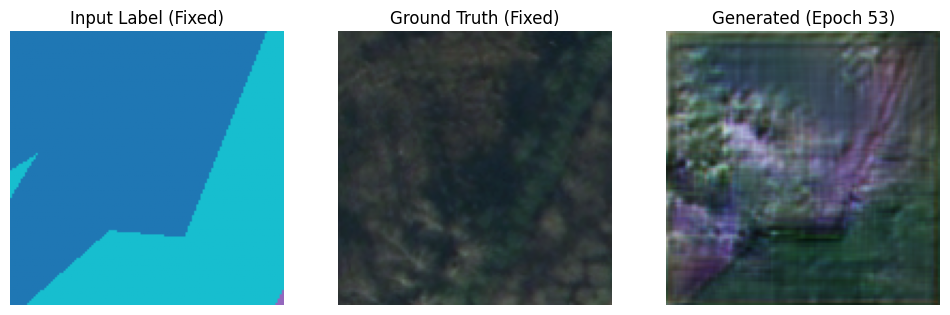

[Ep 54][Bt 0] D:-0.061 G:2.552 OT:0.175 T:297.4m
[Ep 54][Bt 20] D:-0.116 G:2.467 OT:0.165 T:298.0m
[Ep 54][Bt 40] D:0.047 G:2.737 OT:0.221 T:298.6m
[Ep 54][Bt 60] D:-0.107 G:2.445 OT:0.147 T:314.2m
[Ep 54][Bt 80] D:-0.020 G:2.378 OT:0.208 T:314.8m
[Ep 54][Bt 100] D:-0.090 G:2.544 OT:0.138 T:330.3m
[Ep 54][Bt 120] D:-0.112 G:2.414 OT:0.150 T:330.9m
[Ep 54][Bt 140] D:-0.015 G:2.285 OT:0.154 T:331.5m


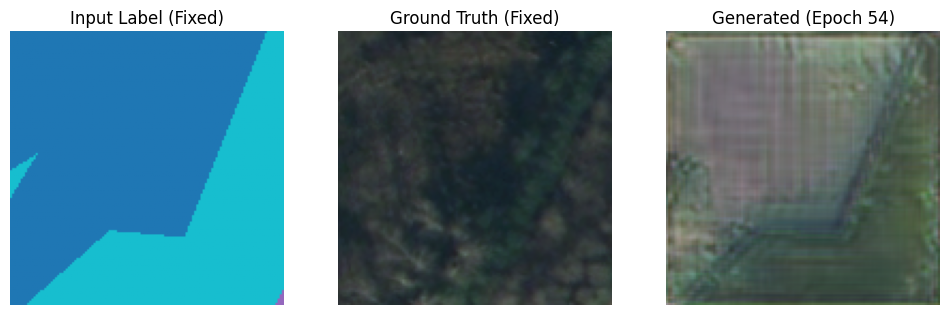

[Ep 55][Bt 0] D:-0.124 G:2.561 OT:0.153 T:332.1m
[Ep 55][Bt 20] D:-0.061 G:2.751 OT:0.173 T:347.6m
[Ep 55][Bt 40] D:0.030 G:2.566 OT:0.150 T:348.2m
[Ep 55][Bt 60] D:0.025 G:2.458 OT:0.120 T:348.8m
[Ep 55][Bt 80] D:0.048 G:2.349 OT:0.161 T:349.4m
[Ep 55][Bt 100] D:0.071 G:2.701 OT:0.173 T:365.0m
[Ep 55][Bt 120] D:-0.021 G:2.871 OT:0.208 T:365.6m
[Ep 55][Bt 140] D:-0.022 G:2.607 OT:0.137 T:366.2m


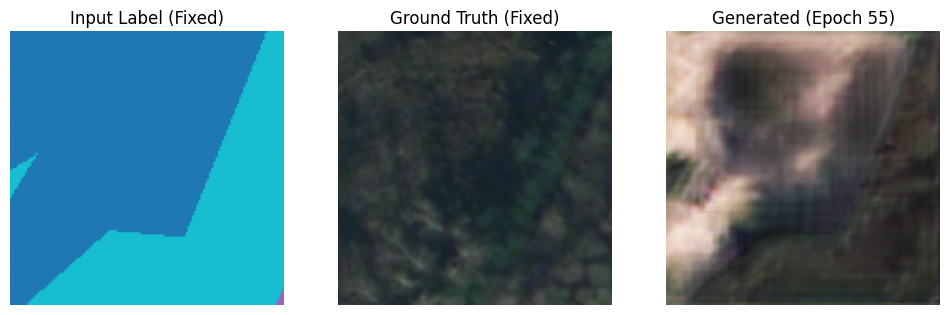

[Ep 56][Bt 0] D:0.050 G:2.569 OT:0.182 T:366.7m
[Ep 56][Bt 20] D:-0.084 G:2.630 OT:0.175 T:367.3m
[Ep 56][Bt 40] D:-0.072 G:2.665 OT:0.162 T:382.9m
[Ep 56][Bt 60] D:-0.143 G:2.741 OT:0.171 T:383.4m
[Ep 56][Bt 80] D:0.007 G:2.323 OT:0.123 T:384.0m
[Ep 56][Bt 100] D:-0.105 G:2.401 OT:0.141 T:384.6m
[Ep 56][Bt 120] D:-0.060 G:2.544 OT:0.172 T:385.2m
[Ep 56][Bt 140] D:0.457 G:2.545 OT:0.250 T:394.2m


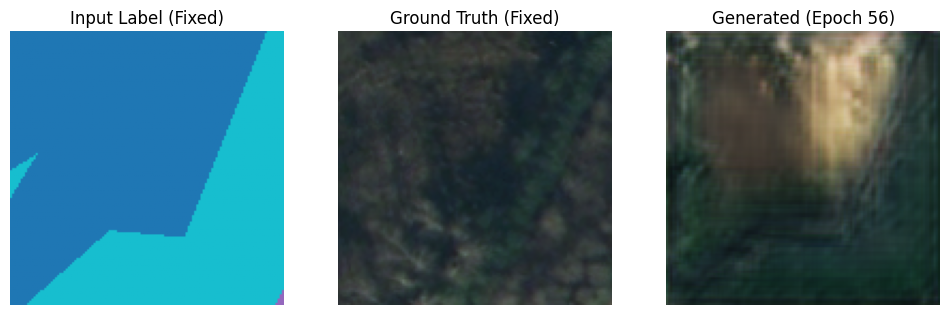

[Ep 57][Bt 0] D:0.091 G:1.967 OT:0.147 T:394.7m
[Ep 57][Bt 20] D:-0.077 G:2.078 OT:0.137 T:395.3m
[Ep 57][Bt 40] D:-0.006 G:2.071 OT:0.108 T:395.9m
[Ep 57][Bt 60] D:0.055 G:2.436 OT:0.169 T:399.2m
[Ep 57][Bt 80] D:-0.045 G:2.387 OT:0.112 T:404.2m
[Ep 57][Bt 100] D:-0.029 G:2.369 OT:0.123 T:404.9m
[Ep 57][Bt 120] D:-0.091 G:2.698 OT:0.177 T:420.4m
[Ep 57][Bt 140] D:-0.064 G:2.723 OT:0.120 T:425.8m


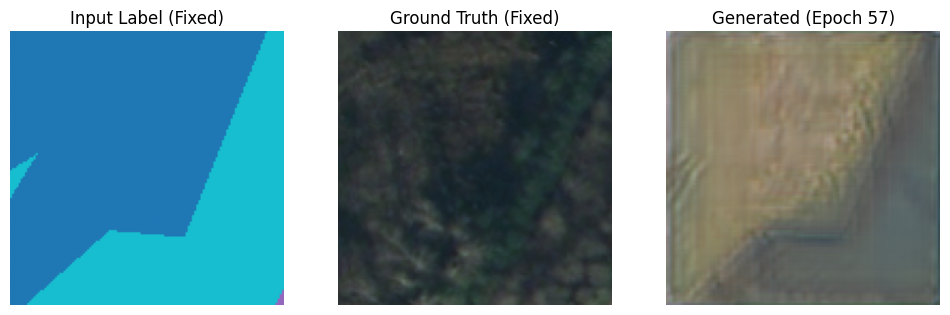

[Ep 58][Bt 0] D:-0.026 G:2.292 OT:0.131 T:426.3m
[Ep 58][Bt 20] D:-0.054 G:2.511 OT:0.222 T:426.9m
[Ep 58][Bt 40] D:0.045 G:2.297 OT:0.131 T:427.5m
[Ep 58][Bt 60] D:0.188 G:2.441 OT:0.192 T:428.1m
[Ep 58][Bt 80] D:-0.089 G:2.523 OT:0.127 T:428.7m
[Ep 58][Bt 100] D:-0.056 G:2.357 OT:0.130 T:429.3m
[Ep 58][Bt 120] D:0.021 G:2.535 OT:0.163 T:429.9m
[Ep 58][Bt 140] D:-0.137 G:2.267 OT:0.144 T:430.5m


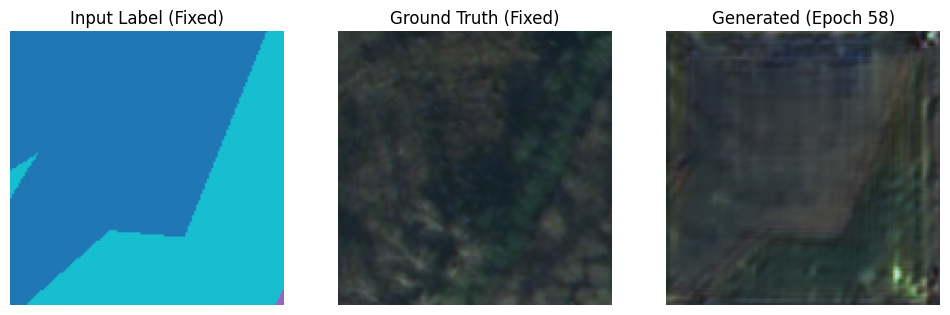

[Ep 59][Bt 0] D:0.068 G:2.214 OT:0.137 T:431.6m
[Ep 59][Bt 20] D:0.020 G:2.447 OT:0.199 T:432.2m
[Ep 59][Bt 40] D:-0.092 G:2.385 OT:0.116 T:432.9m
[Ep 59][Bt 60] D:0.012 G:2.340 OT:0.139 T:433.5m
[Ep 59][Bt 80] D:0.127 G:2.267 OT:0.126 T:434.3m
[Ep 59][Bt 100] D:-0.148 G:2.410 OT:0.183 T:435.0m
[Ep 59][Bt 120] D:-0.006 G:2.437 OT:0.134 T:435.7m
[Ep 59][Bt 140] D:-0.094 G:2.524 OT:0.127 T:436.5m


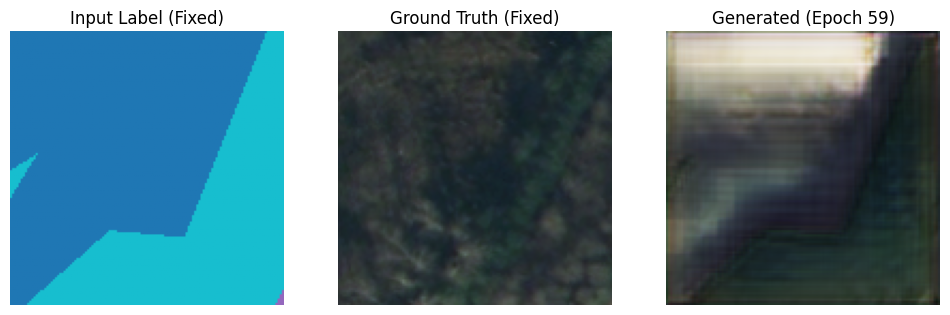

[Ep 60][Bt 0] D:0.099 G:2.647 OT:0.194 T:437.1m
[Ep 60][Bt 20] D:0.095 G:2.637 OT:0.176 T:437.9m
[Ep 60][Bt 40] D:0.068 G:2.669 OT:0.179 T:438.6m
[Ep 60][Bt 60] D:-0.088 G:2.688 OT:0.175 T:439.3m
[Ep 60][Bt 80] D:-0.081 G:2.635 OT:0.172 T:440.0m
[Ep 60][Bt 100] D:-0.030 G:2.537 OT:0.130 T:440.8m
[Ep 60][Bt 120] D:-0.026 G:2.656 OT:0.138 T:441.5m
[Ep 60][Bt 140] D:-0.021 G:2.679 OT:0.147 T:442.2m


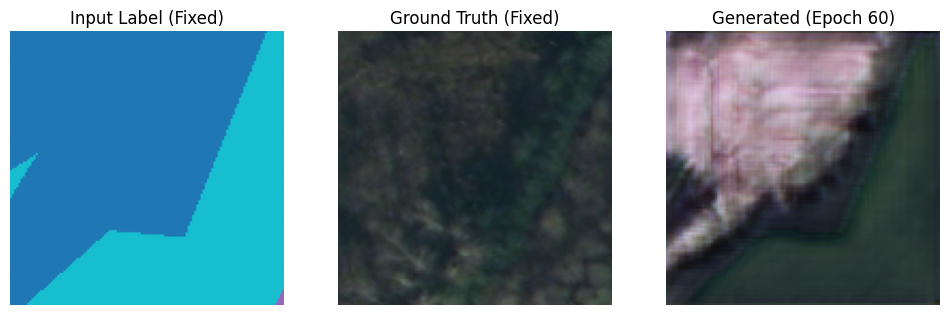

[Ep 61][Bt 0] D:-0.007 G:2.560 OT:0.154 T:442.9m
[Ep 61][Bt 20] D:0.011 G:2.734 OT:0.169 T:443.6m
[Ep 61][Bt 40] D:-0.056 G:2.520 OT:0.115 T:444.4m
[Ep 61][Bt 60] D:-0.042 G:2.706 OT:0.102 T:445.1m
[Ep 61][Bt 80] D:-0.102 G:2.890 OT:0.151 T:445.9m
[Ep 61][Bt 100] D:-0.061 G:2.855 OT:0.187 T:446.6m
[Ep 61][Bt 120] D:-0.010 G:2.726 OT:0.137 T:447.4m
[Ep 61][Bt 140] D:0.290 G:2.424 OT:0.158 T:448.2m


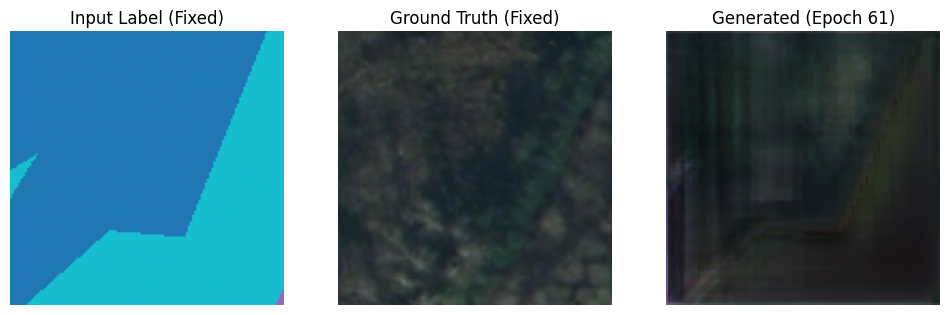

[Ep 62][Bt 0] D:-0.062 G:2.706 OT:0.113 T:448.8m
[Ep 62][Bt 20] D:0.047 G:2.628 OT:0.157 T:449.6m
[Ep 62][Bt 40] D:0.107 G:2.522 OT:0.131 T:450.2m
[Ep 62][Bt 60] D:-0.110 G:2.636 OT:0.122 T:450.8m
[Ep 62][Bt 80] D:-0.079 G:2.769 OT:0.166 T:451.4m
[Ep 62][Bt 100] D:-0.036 G:2.508 OT:0.164 T:452.0m
[Ep 62][Bt 120] D:0.100 G:2.514 OT:0.157 T:452.6m
[Ep 62][Bt 140] D:-0.005 G:2.754 OT:0.182 T:453.2m


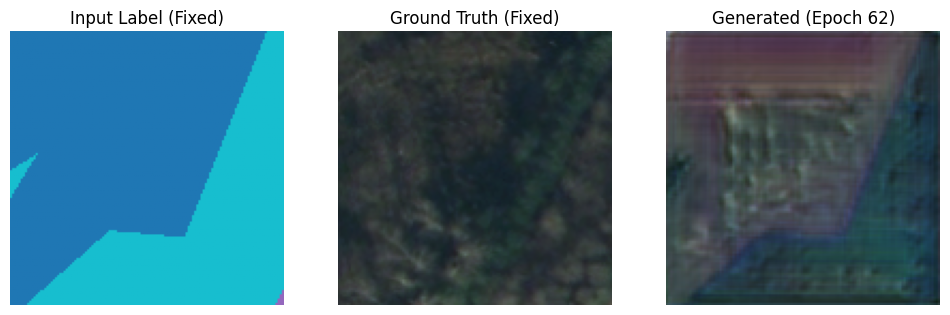

[Ep 63][Bt 0] D:-0.056 G:2.873 OT:0.156 T:453.8m
[Ep 63][Bt 20] D:-0.001 G:2.688 OT:0.152 T:454.4m
[Ep 63][Bt 40] D:0.020 G:2.818 OT:0.110 T:455.0m
[Ep 63][Bt 60] D:-0.008 G:2.978 OT:0.159 T:455.6m
[Ep 63][Bt 80] D:0.024 G:3.071 OT:0.151 T:456.2m
[Ep 63][Bt 100] D:-0.009 G:2.855 OT:0.164 T:456.8m
[Ep 63][Bt 120] D:-0.164 G:3.158 OT:0.187 T:457.4m
[Ep 63][Bt 140] D:-0.097 G:3.018 OT:0.139 T:458.0m


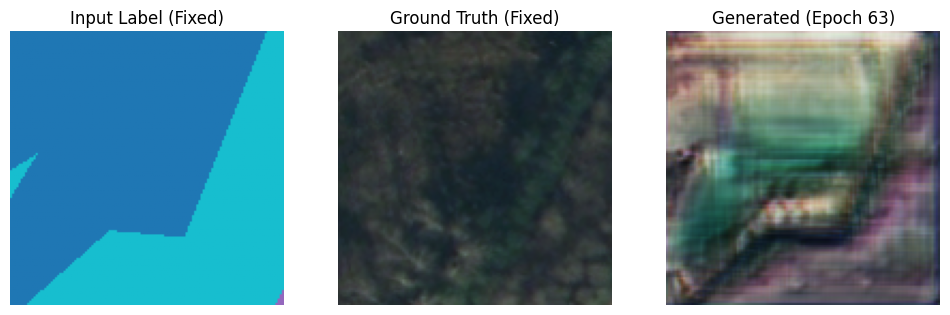

[Ep 64][Bt 0] D:0.077 G:3.103 OT:0.163 T:458.5m
[Ep 64][Bt 20] D:-0.066 G:2.939 OT:0.128 T:459.1m
[Ep 64][Bt 40] D:-0.098 G:2.941 OT:0.127 T:459.7m
[Ep 64][Bt 60] D:0.027 G:2.640 OT:0.148 T:460.3m
[Ep 64][Bt 80] D:0.165 G:2.670 OT:0.220 T:461.0m
[Ep 64][Bt 100] D:-0.042 G:2.809 OT:0.189 T:461.6m
[Ep 64][Bt 120] D:-0.028 G:2.272 OT:0.173 T:462.2m
[Ep 64][Bt 140] D:-0.011 G:2.201 OT:0.181 T:462.8m


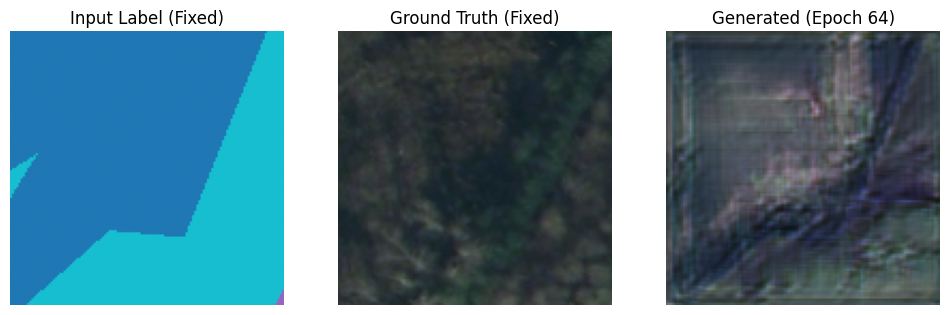

[Ep 65][Bt 0] D:-0.079 G:2.540 OT:0.147 T:463.3m
[Ep 65][Bt 20] D:-0.172 G:2.704 OT:0.162 T:463.9m
[Ep 65][Bt 40] D:-0.028 G:2.655 OT:0.142 T:464.5m
[Ep 65][Bt 60] D:-0.106 G:2.945 OT:0.144 T:465.1m
[Ep 65][Bt 80] D:-0.056 G:2.796 OT:0.186 T:465.7m
[Ep 65][Bt 100] D:-0.074 G:2.732 OT:0.146 T:466.3m
[Ep 65][Bt 120] D:0.010 G:2.665 OT:0.167 T:466.9m
[Ep 65][Bt 140] D:-0.107 G:2.620 OT:0.175 T:467.6m


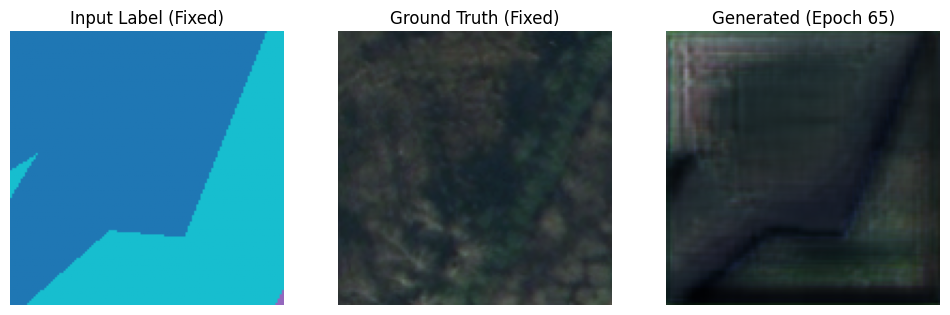

[Ep 66][Bt 0] D:-0.035 G:2.822 OT:0.165 T:468.1m
[Ep 66][Bt 20] D:0.167 G:2.496 OT:0.153 T:468.7m
[Ep 66][Bt 40] D:0.089 G:2.678 OT:0.142 T:469.3m
[Ep 66][Bt 60] D:0.040 G:2.743 OT:0.160 T:469.9m
[Ep 66][Bt 80] D:0.070 G:2.733 OT:0.175 T:470.5m
[Ep 66][Bt 100] D:-0.114 G:2.617 OT:0.166 T:471.2m
[Ep 66][Bt 120] D:0.019 G:2.578 OT:0.147 T:471.9m
[Ep 66][Bt 140] D:-0.053 G:2.949 OT:0.164 T:472.6m


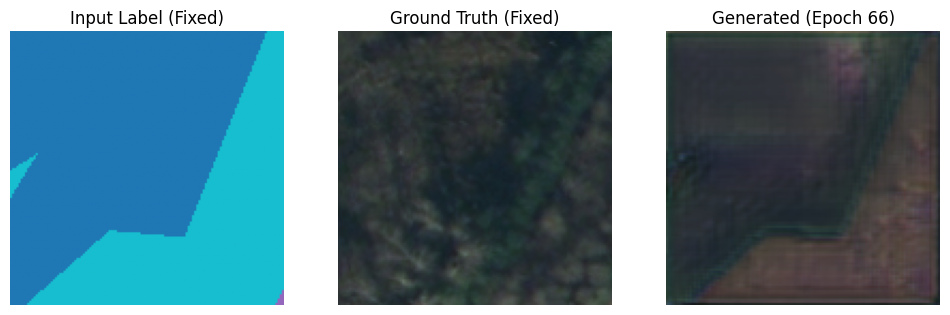

[Ep 67][Bt 0] D:-0.042 G:2.605 OT:0.110 T:473.3m
[Ep 67][Bt 20] D:0.022 G:2.955 OT:0.181 T:474.2m
[Ep 67][Bt 40] D:0.193 G:2.542 OT:0.156 T:474.9m
[Ep 67][Bt 60] D:0.208 G:2.471 OT:0.151 T:475.5m
[Ep 67][Bt 80] D:-0.042 G:2.579 OT:0.172 T:476.2m
[Ep 67][Bt 100] D:-0.095 G:2.489 OT:0.141 T:476.9m
[Ep 67][Bt 120] D:-0.032 G:2.700 OT:0.134 T:477.5m
[Ep 67][Bt 140] D:0.039 G:2.444 OT:0.146 T:478.1m


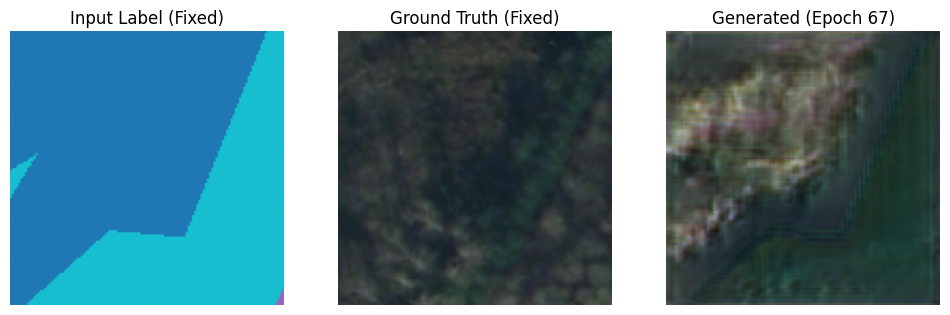

[Ep 68][Bt 0] D:-0.011 G:2.491 OT:0.145 T:478.7m
[Ep 68][Bt 20] D:-0.162 G:2.584 OT:0.142 T:479.3m
[Ep 68][Bt 40] D:-0.032 G:2.760 OT:0.150 T:479.9m
[Ep 68][Bt 60] D:0.053 G:2.801 OT:0.223 T:480.5m
[Ep 68][Bt 80] D:0.068 G:2.775 OT:0.161 T:481.1m
[Ep 68][Bt 100] D:-0.061 G:2.731 OT:0.127 T:481.8m
[Ep 68][Bt 120] D:-0.078 G:2.731 OT:0.108 T:482.5m
[Ep 68][Bt 140] D:0.096 G:2.872 OT:0.142 T:483.2m


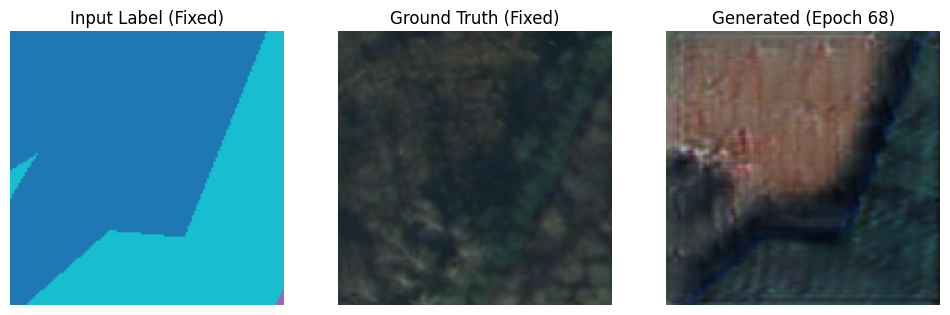

[Ep 69][Bt 0] D:-0.027 G:2.770 OT:0.119 T:483.8m
[Ep 69][Bt 20] D:-0.056 G:2.803 OT:0.138 T:484.4m
[Ep 69][Bt 40] D:-0.130 G:2.789 OT:0.140 T:485.1m
[Ep 69][Bt 60] D:0.040 G:2.899 OT:0.207 T:485.8m
[Ep 69][Bt 80] D:-0.052 G:2.734 OT:0.133 T:486.4m
[Ep 69][Bt 100] D:-0.012 G:2.472 OT:0.129 T:487.0m
[Ep 69][Bt 120] D:-0.127 G:2.241 OT:0.079 T:487.7m
[Ep 69][Bt 140] D:0.041 G:2.417 OT:0.130 T:488.3m


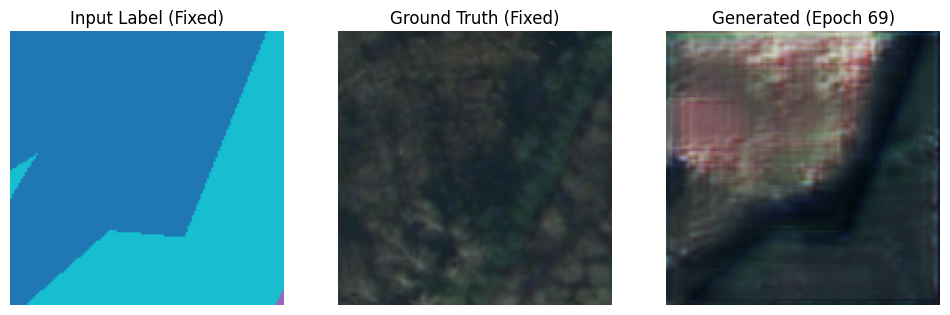

[Ep 70][Bt 0] D:0.049 G:2.390 OT:0.120 T:488.8m
[Ep 70][Bt 20] D:0.060 G:2.742 OT:0.203 T:489.4m
[Ep 70][Bt 40] D:0.063 G:2.733 OT:0.190 T:490.0m
[Ep 70][Bt 60] D:0.024 G:2.570 OT:0.163 T:490.7m
[Ep 70][Bt 80] D:0.046 G:2.832 OT:0.169 T:491.4m
[Ep 70][Bt 100] D:-0.025 G:2.968 OT:0.167 T:492.1m
[Ep 70][Bt 120] D:0.106 G:2.743 OT:0.145 T:493.0m
[Ep 70][Bt 140] D:-0.007 G:2.858 OT:0.139 T:493.8m


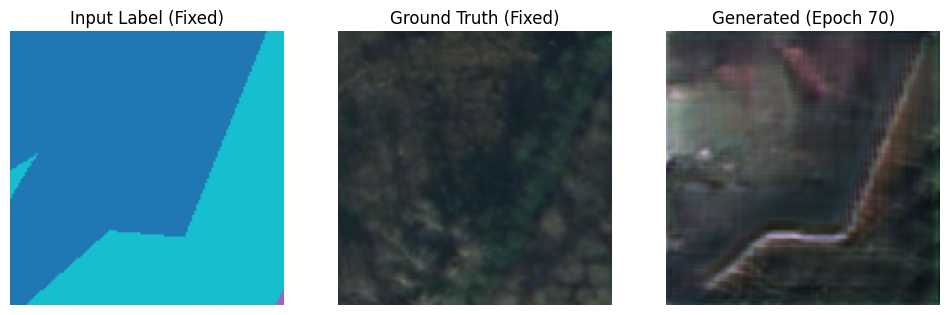

[Ep 71][Bt 0] D:0.002 G:2.569 OT:0.111 T:494.4m
[Ep 71][Bt 20] D:-0.006 G:2.547 OT:0.132 T:495.2m
[Ep 71][Bt 40] D:0.037 G:2.413 OT:0.131 T:495.8m
[Ep 71][Bt 60] D:0.026 G:2.595 OT:0.119 T:496.4m
[Ep 71][Bt 80] D:-0.002 G:2.489 OT:0.131 T:497.1m
[Ep 71][Bt 100] D:-0.082 G:2.426 OT:0.104 T:497.7m
[Ep 71][Bt 120] D:0.013 G:2.758 OT:0.124 T:498.3m
[Ep 71][Bt 140] D:0.061 G:2.555 OT:0.149 T:498.9m


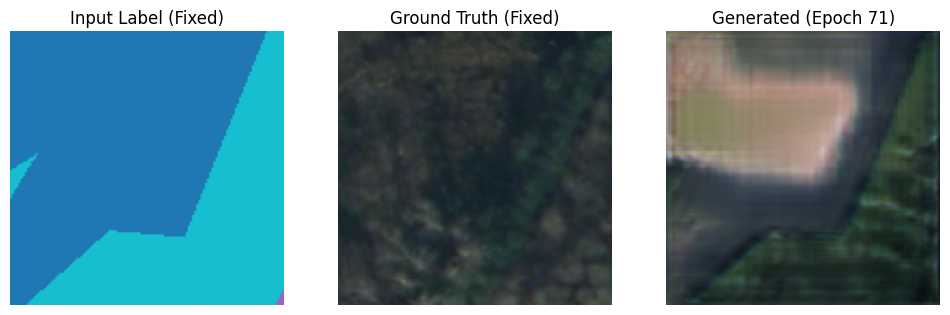

[Ep 72][Bt 0] D:-0.035 G:2.577 OT:0.151 T:499.5m
[Ep 72][Bt 20] D:0.159 G:2.609 OT:0.165 T:500.1m
[Ep 72][Bt 40] D:0.039 G:2.785 OT:0.137 T:500.7m
[Ep 72][Bt 60] D:0.103 G:2.445 OT:0.140 T:501.5m
[Ep 72][Bt 80] D:0.035 G:2.585 OT:0.156 T:502.1m
[Ep 72][Bt 100] D:0.017 G:2.672 OT:0.173 T:502.8m
[Ep 72][Bt 120] D:0.012 G:2.578 OT:0.127 T:503.5m
[Ep 72][Bt 140] D:-0.036 G:2.984 OT:0.134 T:504.2m


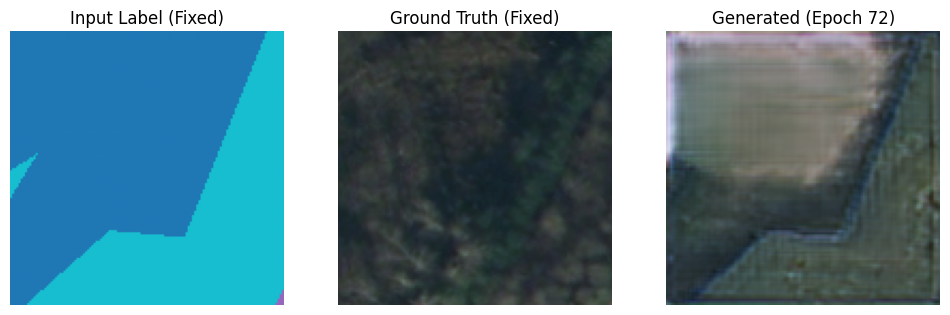

[Ep 73][Bt 0] D:-0.105 G:2.934 OT:0.157 T:504.8m
[Ep 73][Bt 20] D:-0.066 G:2.950 OT:0.151 T:505.4m
[Ep 73][Bt 40] D:-0.079 G:3.156 OT:0.126 T:506.0m
[Ep 73][Bt 60] D:-0.028 G:2.777 OT:0.116 T:506.7m
[Ep 73][Bt 80] D:0.083 G:2.317 OT:0.142 T:507.3m
[Ep 73][Bt 100] D:0.078 G:2.552 OT:0.138 T:508.2m
[Ep 73][Bt 120] D:0.013 G:2.463 OT:0.097 T:508.9m
[Ep 73][Bt 140] D:-0.080 G:2.879 OT:0.134 T:509.5m


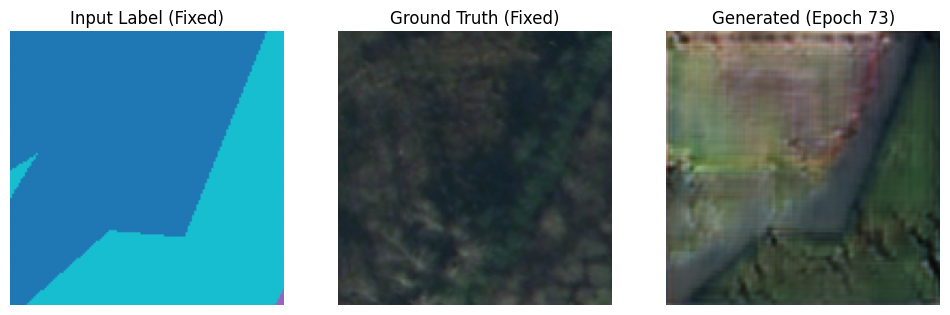

[Ep 74][Bt 0] D:-0.006 G:2.837 OT:0.147 T:510.1m
[Ep 74][Bt 20] D:-0.101 G:2.778 OT:0.171 T:510.8m
[Ep 74][Bt 40] D:0.116 G:2.888 OT:0.181 T:511.5m
[Ep 74][Bt 60] D:-0.169 G:2.739 OT:0.113 T:512.3m
[Ep 74][Bt 80] D:0.140 G:2.646 OT:0.142 T:513.0m
[Ep 74][Bt 100] D:-0.002 G:2.538 OT:0.145 T:513.7m
[Ep 74][Bt 120] D:0.081 G:2.654 OT:0.189 T:514.4m
[Ep 74][Bt 140] D:0.230 G:2.846 OT:0.188 T:515.1m


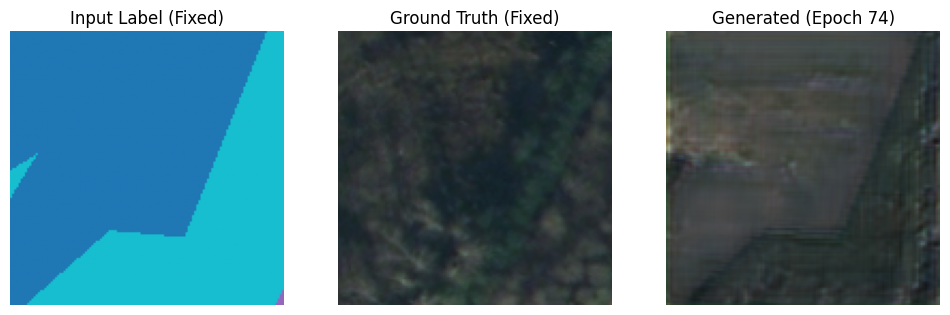

[Ep 75][Bt 0] D:-0.042 G:2.705 OT:0.129 T:515.7m
[Ep 75][Bt 20] D:0.022 G:2.611 OT:0.133 T:516.4m
[Ep 75][Bt 40] D:-0.010 G:2.187 OT:0.108 T:517.1m
[Ep 75][Bt 60] D:0.121 G:2.743 OT:0.195 T:517.8m
[Ep 75][Bt 80] D:-0.059 G:2.646 OT:0.174 T:518.5m
[Ep 75][Bt 100] D:-0.186 G:3.037 OT:0.137 T:519.2m
[Ep 75][Bt 120] D:-0.125 G:2.594 OT:0.107 T:520.0m
[Ep 75][Bt 140] D:-0.186 G:2.779 OT:0.148 T:520.8m


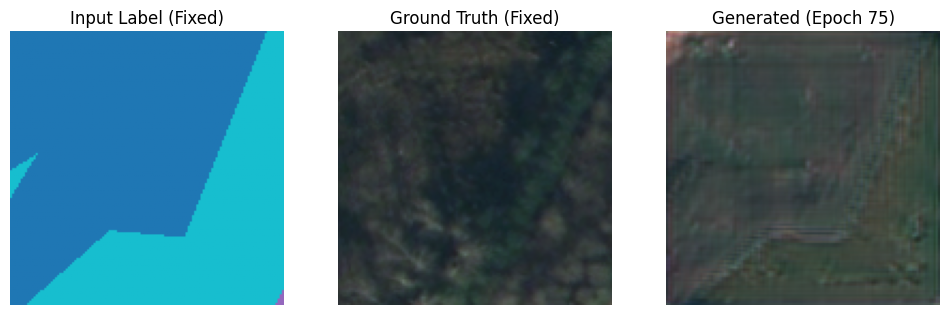

[Ep 76][Bt 0] D:0.002 G:2.776 OT:0.153 T:521.5m
[Ep 76][Bt 20] D:-0.019 G:2.899 OT:0.166 T:522.2m
[Ep 76][Bt 40] D:-0.079 G:2.667 OT:0.158 T:523.0m
[Ep 76][Bt 60] D:0.019 G:2.651 OT:0.159 T:523.8m
[Ep 76][Bt 80] D:-0.119 G:2.790 OT:0.120 T:524.6m
[Ep 76][Bt 100] D:-0.166 G:2.723 OT:0.116 T:525.3m
[Ep 76][Bt 120] D:0.166 G:2.384 OT:0.186 T:526.0m
[Ep 76][Bt 140] D:0.045 G:2.401 OT:0.151 T:526.8m


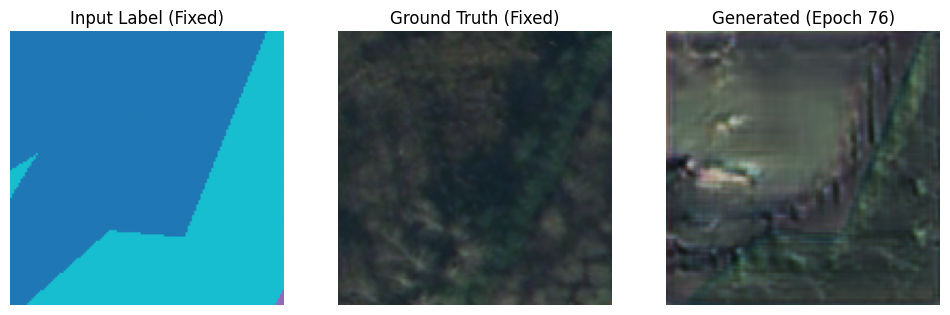

[Ep 77][Bt 0] D:-0.087 G:2.492 OT:0.133 T:527.5m
[Ep 77][Bt 20] D:-0.087 G:3.022 OT:0.169 T:528.3m
[Ep 77][Bt 40] D:0.017 G:2.380 OT:0.103 T:529.0m
[Ep 77][Bt 60] D:0.005 G:2.080 OT:0.100 T:529.7m
[Ep 77][Bt 80] D:0.057 G:2.295 OT:0.148 T:530.4m
[Ep 77][Bt 100] D:-0.022 G:2.291 OT:0.134 T:531.2m
[Ep 77][Bt 120] D:0.063 G:2.569 OT:0.131 T:531.9m
[Ep 77][Bt 140] D:0.043 G:2.734 OT:0.128 T:532.7m


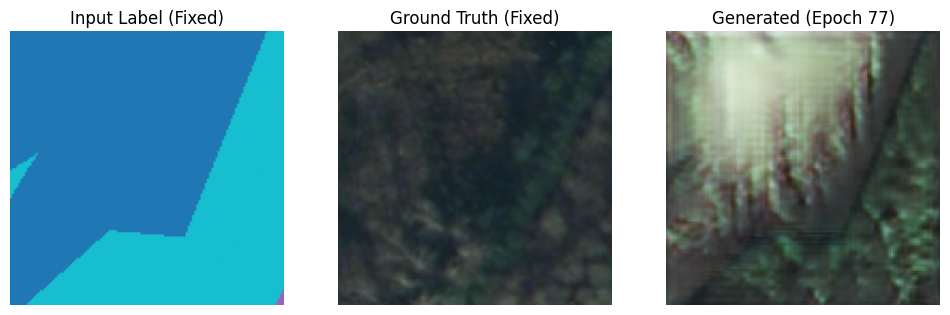

[Ep 78][Bt 0] D:0.093 G:2.353 OT:0.183 T:533.4m
[Ep 78][Bt 20] D:-0.054 G:2.163 OT:0.124 T:534.2m
[Ep 78][Bt 40] D:0.009 G:2.648 OT:0.132 T:535.1m
[Ep 78][Bt 60] D:-0.036 G:2.745 OT:0.120 T:535.9m
[Ep 78][Bt 80] D:-0.001 G:2.866 OT:0.127 T:536.7m
[Ep 78][Bt 100] D:-0.085 G:3.087 OT:0.175 T:537.5m
[Ep 78][Bt 120] D:0.042 G:3.046 OT:0.169 T:538.7m
[Ep 78][Bt 140] D:-0.122 G:2.726 OT:0.094 T:539.8m


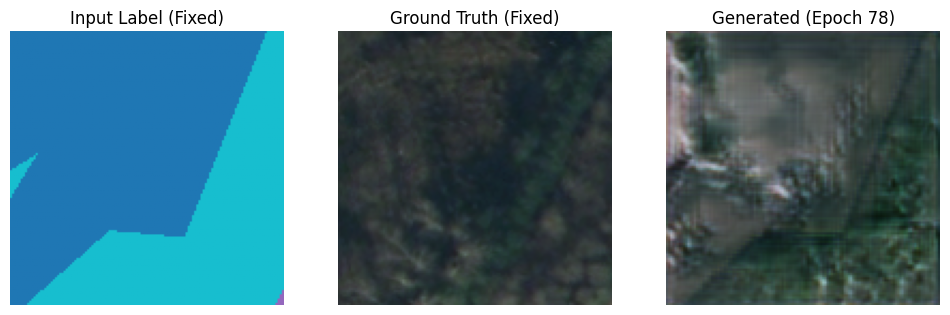

[Ep 79][Bt 0] D:0.014 G:2.788 OT:0.140 T:540.6m
[Ep 79][Bt 20] D:-0.062 G:3.258 OT:0.164 T:541.5m
[Ep 79][Bt 40] D:-0.193 G:3.207 OT:0.145 T:542.3m
[Ep 79][Bt 60] D:-0.248 G:3.228 OT:0.160 T:543.2m
[Ep 79][Bt 80] D:-0.065 G:2.851 OT:0.155 T:543.9m
[Ep 79][Bt 100] D:0.010 G:2.672 OT:0.150 T:544.7m
[Ep 79][Bt 120] D:-0.052 G:2.785 OT:0.141 T:545.4m
[Ep 79][Bt 140] D:-0.028 G:2.714 OT:0.142 T:546.2m


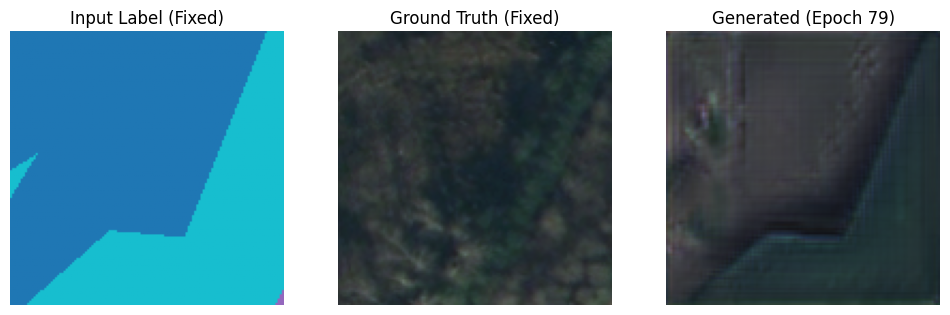

[Ep 80][Bt 0] D:-0.089 G:2.683 OT:0.109 T:546.9m
[Ep 80][Bt 20] D:0.031 G:2.980 OT:0.171 T:547.8m
[Ep 80][Bt 40] D:0.095 G:2.800 OT:0.156 T:548.6m
[Ep 80][Bt 60] D:0.210 G:2.377 OT:0.197 T:549.5m
[Ep 80][Bt 80] D:-0.059 G:2.545 OT:0.159 T:550.3m
[Ep 80][Bt 100] D:0.009 G:2.382 OT:0.090 T:551.1m
[Ep 80][Bt 120] D:-0.015 G:2.466 OT:0.142 T:551.8m
[Ep 80][Bt 140] D:-0.086 G:2.653 OT:0.135 T:552.6m


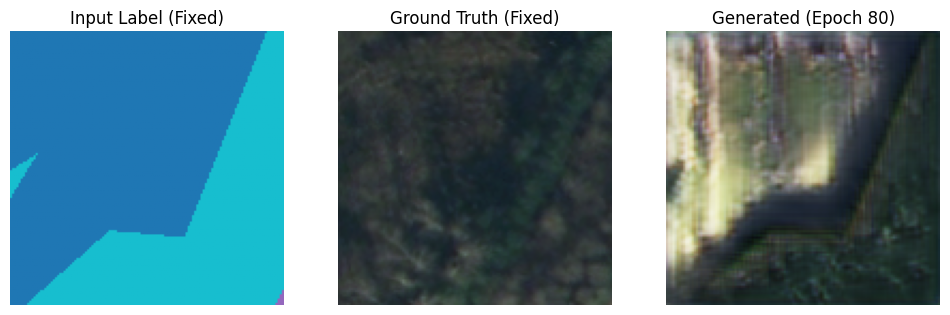

[Ep 81][Bt 0] D:0.136 G:2.904 OT:0.150 T:553.4m
[Ep 81][Bt 20] D:-0.057 G:3.043 OT:0.129 T:554.1m
[Ep 81][Bt 40] D:0.024 G:2.928 OT:0.132 T:554.8m
[Ep 81][Bt 60] D:-0.020 G:3.242 OT:0.142 T:555.5m
[Ep 81][Bt 80] D:0.040 G:3.083 OT:0.160 T:556.2m
[Ep 81][Bt 100] D:0.016 G:3.158 OT:0.148 T:556.9m
[Ep 81][Bt 120] D:0.086 G:2.889 OT:0.135 T:557.9m
[Ep 81][Bt 140] D:0.061 G:2.779 OT:0.146 T:558.7m


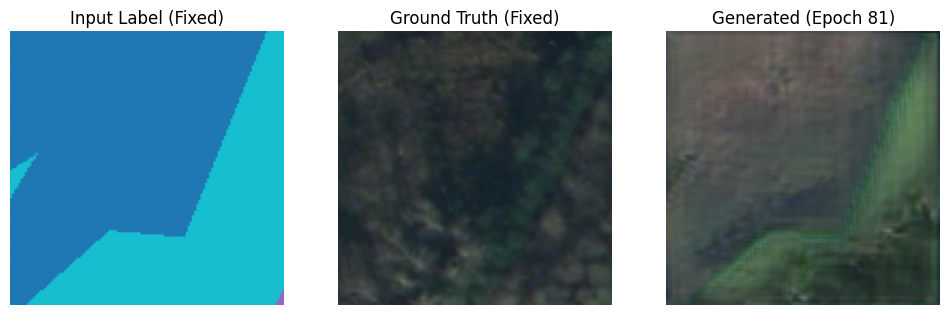

[Ep 82][Bt 0] D:0.060 G:2.894 OT:0.150 T:559.5m
[Ep 82][Bt 20] D:-0.045 G:2.630 OT:0.145 T:560.1m
[Ep 82][Bt 40] D:-0.072 G:2.576 OT:0.121 T:560.8m
[Ep 82][Bt 60] D:0.021 G:2.610 OT:0.114 T:561.6m
[Ep 82][Bt 80] D:-0.066 G:2.658 OT:0.121 T:562.4m
[Ep 82][Bt 100] D:0.009 G:2.832 OT:0.133 T:563.1m
[Ep 82][Bt 120] D:0.038 G:3.027 OT:0.108 T:563.8m
[Ep 82][Bt 140] D:-0.004 G:3.306 OT:0.100 T:564.4m


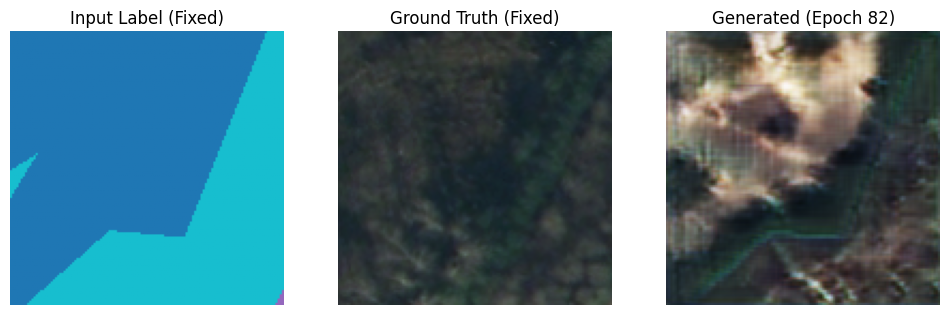

[Ep 83][Bt 0] D:0.032 G:3.232 OT:0.169 T:565.1m
[Ep 83][Bt 20] D:-0.042 G:3.241 OT:0.137 T:565.9m
[Ep 83][Bt 40] D:-0.020 G:3.322 OT:0.144 T:566.7m
[Ep 83][Bt 60] D:-0.094 G:3.227 OT:0.125 T:567.5m
[Ep 83][Bt 80] D:-0.029 G:3.641 OT:0.139 T:568.2m
[Ep 83][Bt 100] D:-0.134 G:3.553 OT:0.153 T:569.2m
[Ep 83][Bt 120] D:0.035 G:2.738 OT:0.197 T:569.9m
[Ep 83][Bt 140] D:0.128 G:2.868 OT:0.153 T:570.6m


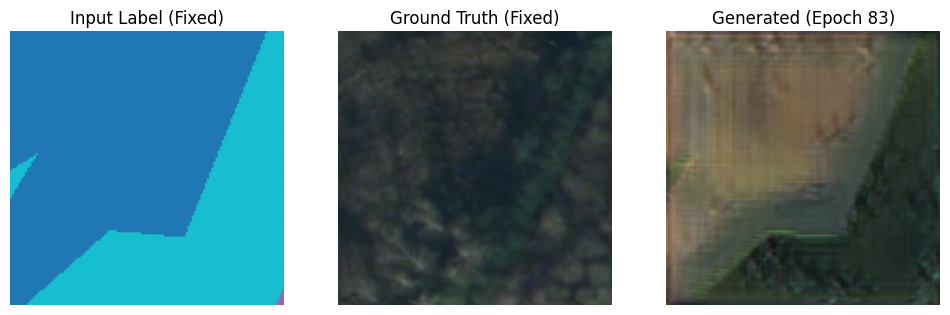

[Ep 84][Bt 0] D:0.114 G:2.655 OT:0.151 T:571.2m
[Ep 84][Bt 20] D:-0.080 G:2.919 OT:0.155 T:572.0m
[Ep 84][Bt 40] D:-0.244 G:3.257 OT:0.139 T:572.8m
[Ep 84][Bt 60] D:0.265 G:3.174 OT:0.173 T:573.6m
[Ep 84][Bt 80] D:-0.059 G:3.359 OT:0.153 T:574.3m
[Ep 84][Bt 100] D:0.070 G:2.998 OT:0.139 T:575.0m
[Ep 84][Bt 120] D:-0.004 G:3.411 OT:0.160 T:575.9m
[Ep 84][Bt 140] D:0.017 G:3.170 OT:0.122 T:576.6m


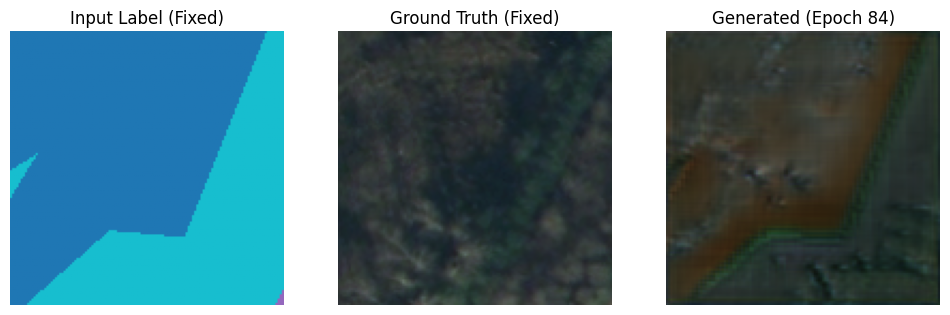

[Ep 85][Bt 0] D:-0.143 G:3.030 OT:0.152 T:577.3m
[Ep 85][Bt 20] D:-0.030 G:3.098 OT:0.140 T:578.1m
[Ep 85][Bt 40] D:-0.080 G:3.274 OT:0.141 T:578.7m
[Ep 85][Bt 60] D:-0.086 G:3.108 OT:0.105 T:579.4m
[Ep 85][Bt 80] D:-0.031 G:2.774 OT:0.123 T:580.0m
[Ep 85][Bt 100] D:0.032 G:3.186 OT:0.152 T:580.6m
[Ep 85][Bt 120] D:-0.003 G:3.307 OT:0.158 T:581.3m
[Ep 85][Bt 140] D:-0.050 G:3.513 OT:0.144 T:582.0m


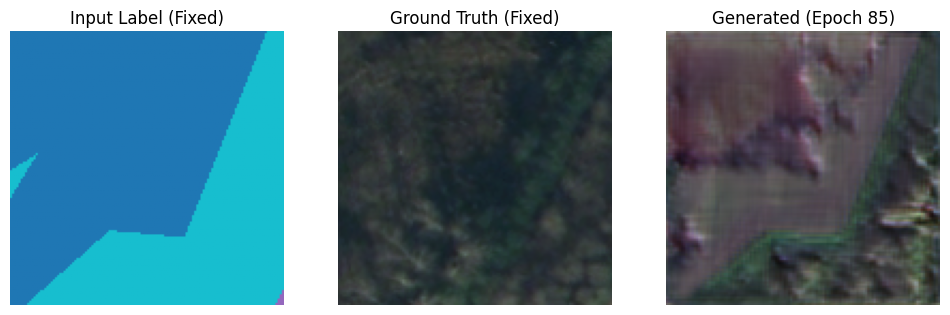

[Ep 86][Bt 0] D:-0.062 G:3.561 OT:0.142 T:582.6m
[Ep 86][Bt 20] D:-0.090 G:3.315 OT:0.086 T:583.3m
[Ep 86][Bt 40] D:-0.003 G:2.778 OT:0.100 T:584.0m
[Ep 86][Bt 60] D:0.145 G:3.225 OT:0.151 T:584.9m
[Ep 86][Bt 80] D:-0.009 G:3.198 OT:0.137 T:585.6m
[Ep 86][Bt 100] D:-0.033 G:3.228 OT:0.183 T:586.3m
[Ep 86][Bt 120] D:0.087 G:3.326 OT:0.196 T:587.0m
[Ep 86][Bt 140] D:-0.003 G:2.947 OT:0.114 T:587.8m


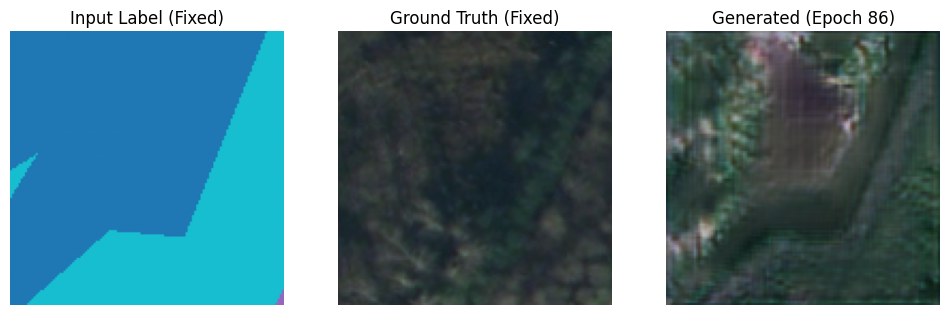

[Ep 87][Bt 0] D:-0.008 G:3.062 OT:0.120 T:588.4m
[Ep 87][Bt 20] D:-0.153 G:3.584 OT:0.137 T:589.5m
[Ep 87][Bt 40] D:0.039 G:3.080 OT:0.153 T:590.2m
[Ep 87][Bt 60] D:0.013 G:3.341 OT:0.133 T:591.0m
[Ep 87][Bt 80] D:-0.016 G:3.295 OT:0.105 T:591.7m
[Ep 87][Bt 100] D:-0.105 G:3.176 OT:0.106 T:592.3m
[Ep 87][Bt 120] D:-0.046 G:3.346 OT:0.119 T:593.1m
[Ep 87][Bt 140] D:-0.019 G:2.938 OT:0.108 T:594.0m


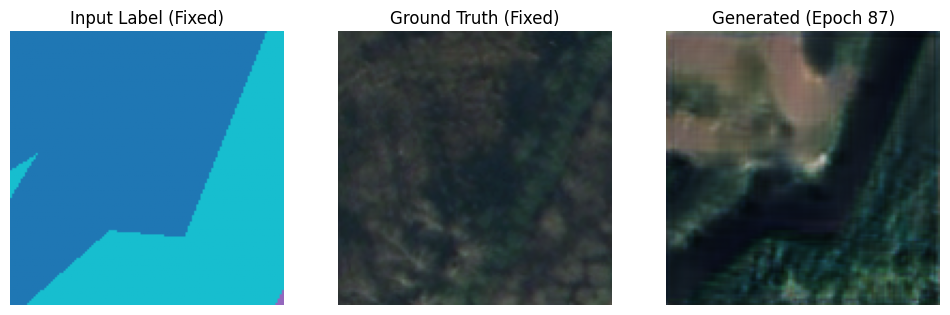

[Ep 88][Bt 0] D:-0.024 G:3.520 OT:0.148 T:595.0m
[Ep 88][Bt 20] D:-0.040 G:3.259 OT:0.126 T:596.6m
[Ep 88][Bt 40] D:0.004 G:3.103 OT:0.151 T:597.9m
[Ep 88][Bt 60] D:0.044 G:2.941 OT:0.147 T:599.2m
[Ep 88][Bt 80] D:-0.062 G:3.300 OT:0.107 T:600.4m
[Ep 88][Bt 100] D:-0.073 G:2.917 OT:0.120 T:601.4m
[Ep 88][Bt 120] D:-0.038 G:3.411 OT:0.167 T:602.7m
[Ep 88][Bt 140] D:-0.005 G:3.202 OT:0.112 T:603.6m


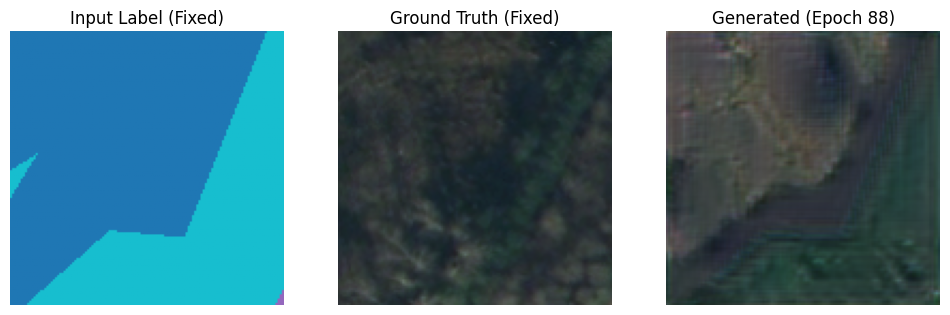

[Ep 89][Bt 0] D:-0.038 G:3.220 OT:0.087 T:604.5m
[Ep 89][Bt 20] D:0.040 G:3.022 OT:0.107 T:605.5m
[Ep 89][Bt 40] D:0.016 G:3.405 OT:0.116 T:606.4m
[Ep 89][Bt 60] D:-0.090 G:3.553 OT:0.157 T:607.3m
[Ep 89][Bt 80] D:0.050 G:3.212 OT:0.108 T:608.6m
[Ep 89][Bt 100] D:0.096 G:3.330 OT:0.131 T:609.6m
[Ep 89][Bt 120] D:0.031 G:3.261 OT:0.115 T:611.0m
[Ep 89][Bt 140] D:0.070 G:3.275 OT:0.132 T:612.0m


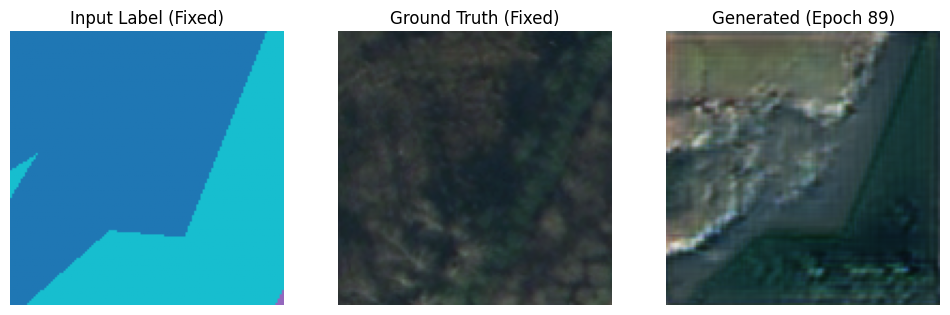

[Ep 90][Bt 0] D:0.010 G:3.189 OT:0.121 T:613.0m
[Ep 90][Bt 20] D:-0.060 G:3.301 OT:0.141 T:614.3m
[Ep 90][Bt 40] D:0.002 G:3.186 OT:0.168 T:615.5m
[Ep 90][Bt 60] D:-0.078 G:3.202 OT:0.100 T:616.7m
[Ep 90][Bt 80] D:-0.083 G:3.037 OT:0.096 T:617.7m
[Ep 90][Bt 100] D:-0.064 G:3.402 OT:0.153 T:618.7m
[Ep 90][Bt 120] D:-0.085 G:3.181 OT:0.157 T:619.6m
[Ep 90][Bt 140] D:0.035 G:3.437 OT:0.129 T:620.3m


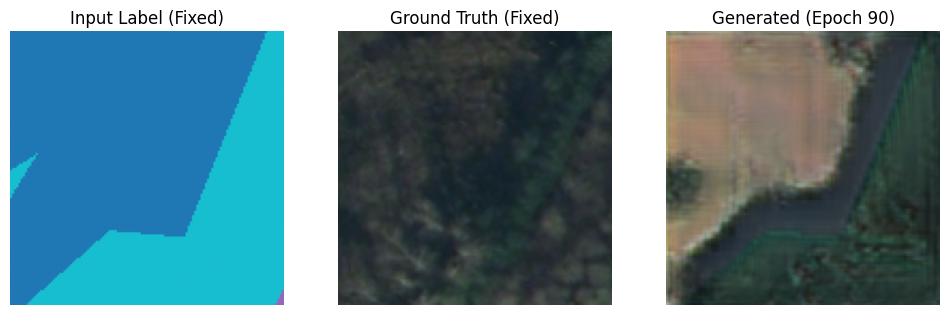

[Ep 91][Bt 0] D:0.017 G:3.487 OT:0.154 T:621.1m
[Ep 91][Bt 20] D:0.041 G:3.422 OT:0.145 T:622.0m
[Ep 91][Bt 40] D:-0.137 G:3.399 OT:0.162 T:622.7m
[Ep 91][Bt 60] D:-0.008 G:3.530 OT:0.108 T:623.5m
[Ep 91][Bt 80] D:-0.052 G:3.533 OT:0.108 T:624.5m


KeyboardInterrupt: 

In [5]:
# --- Initialization ---
G = Generator().to(DEVICE)
D = Discriminator().to(DEVICE)
opt_G = torch.optim.Adam(G.parameters(), lr=LR, betas=(B1, B2))
opt_D = torch.optim.Adam(D.parameters(), lr=LR, betas=(B1, B2))

# --- CRITICAL CHANGE: Create a Fixed Batch for Visualization ---
print("📸 Creating fixed visualization batch...")
fixed_batch = next(iter(dataloader))
fixed_real = fixed_batch['image'].to(DEVICE)
fixed_mask = fixed_batch['mask'].to(DEVICE)
# --------------------------------------------------------------

print("🔥 Models Initialized. Starting Training...")
start_time = time.time()

for epoch in range(N_EPOCHS):
    for i, batch in enumerate(dataloader):
        real_img = batch['image'].to(DEVICE)
        mask = batch['mask'].to(DEVICE)
        
        # -----------------------
        # 1. Train Discriminator
        # -----------------------
        opt_D.zero_grad()
        fake_img = G(mask).detach()
        
        # Real/Fake Scores
        d_real, _ = D(real_img, mask)
        d_fake, _ = D(fake_img, mask)
        
        # Gradient Penalty
        gp = compute_gp(D, real_img, fake_img, mask)
        
        # D Loss
        loss_D = torch.mean(d_fake) - torch.mean(d_real) + (LAMBDA_GP * gp)
        loss_D.backward()
        opt_D.step()
        
        # -----------------------
        # 2. Train Generator
        # -----------------------
        opt_G.zero_grad()
        gen_img = G(mask)
        
        # Adversarial + OT Loss
        d_fake, gen_feats = D(gen_img, mask)
        
        # Get real features (no grad needed)
        with torch.no_grad():
            _, real_feats = D(real_img, mask)
            
        loss_ot = compute_ot_loss(gen_feats, real_feats)
        loss_G = -torch.mean(d_fake) + (LAMBDA_OT * loss_ot)
        
        loss_G.backward()
        opt_G.step()
        
        # Logging (Sparse logging for speed)
        if i % 20 == 0:
            elapsed = (time.time() - start_time) / 60
            print(f"[Ep {epoch}][Bt {i}] D:{loss_D.item():.3f} G:{loss_G.item():.3f} OT:{loss_ot.item():.3f} T:{elapsed:.1f}m")

    # --- Better Visualization (Using FIXED Batch) ---
    with torch.no_grad():
        # 1. Generate using the FIXED mask we saved at the start
        fixed_fake = G(fixed_mask).detach()
        
        # 2. Process the FIRST image [0] from the FIXED batch
        fake_vis = fixed_fake[0].cpu().permute(1, 2, 0) * 0.5 + 0.5
        real_vis = fixed_real[0].cpu().permute(1, 2, 0) * 0.5 + 0.5
        
        # 3. Process the mask
        mask_vis = torch.argmax(fixed_mask[0], dim=0).cpu().numpy()

        fig, ax = plt.subplots(1, 3, figsize=(12, 4))
        
        # Plot Mask
        ax[0].imshow(mask_vis, cmap='tab10') 
        ax[0].set_title("Input Label (Fixed)")
        ax[0].axis('off')

        # Plot Real
        ax[1].imshow(real_vis)
        ax[1].set_title("Ground Truth (Fixed)")
        ax[1].axis('off')

        # Plot Generated
        ax[2].imshow(fake_vis)
        ax[2].set_title(f"Generated (Epoch {epoch})")
        ax[2].axis('off')
        
        plt.show()
        
        # Save Checkpoint
        if epoch % 10 == 0:
            torch.save(G.state_dict(), f"generator_epoch_{epoch}.pth")

✅ Loading weights from: generator_epoch_90.pth
Validation Set Size: 1669 images
🎨 Rendering 30 samples... (Scroll down)
💾 Saved full visualization to results_30_samples.png


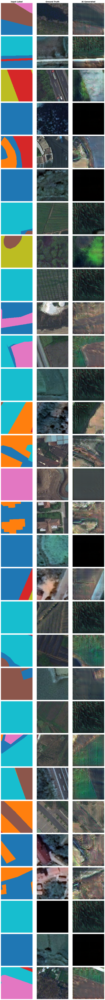

In [10]:
import os
import glob
import torch
import numpy as np
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader
# Assuming Generator, LoveDADataset, etc. are already defined in your notebook

# --- Configuration ---
DEVICE = torch.device("mps" if torch.backends.mps.is_available() else "cpu")
IMG_SIZE = 128
NUM_CLASSES = 7
NUM_SAMPLES_TO_SHOW = 30  # We want 30 samples

# 1. Initialize Generator
# Note: Ensure the Generator class definition is in memory
model = Generator(label_nc=NUM_CLASSES).to(DEVICE)

# 2. Find and Load Weights
checkpoints = sorted(glob.glob("generator_epoch_*.pth"), key=os.path.getmtime)
if len(checkpoints) > 0:
    latest = checkpoints[-1]
    print(f"✅ Loading weights from: {latest}")
    model.load_state_dict(torch.load(latest, map_location=DEVICE))
    model.eval()
else:
    print("❌ No checkpoint found! Run training first.")

# 3. Large Batch Validation Loader
# We set batch_size=32 to ensure we grab at least 30 images in the first iteration
val_dataset = LoveDADataset(DATA_ROOT, split='Val', transform=True)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=True, num_workers=0)

print(f"Validation Set Size: {len(val_dataset)} images")

def visualize_large_batch(generator, loader, num_samples=30):
    # 1. Get a large batch (32 images)
    batch = next(iter(loader))
    real_imgs = batch['image'].to(DEVICE)
    masks = batch['mask'].to(DEVICE)
    
    # 2. Run Inference on the whole batch
    with torch.no_grad():
        fake_imgs = generator(masks)

    # 3. Prepare Plotting
    # We limit to num_samples in case batch size > num_samples
    real_imgs = real_imgs[:num_samples]
    masks = masks[:num_samples]
    fake_imgs = fake_imgs[:num_samples]
    
    # Dynamic Figure Height: 3.5 inches per row * 30 rows = ~105 inches tall
    fig, axs = plt.subplots(num_samples, 3, figsize=(12, 3.5 * num_samples))
    
    def denorm(t):
        return t.cpu().permute(1, 2, 0).numpy() * 0.5 + 0.5

    print(f"🎨 Rendering {num_samples} samples... (Scroll down)")

    for i in range(num_samples):
        # Decode Mask (OneHot -> Index)
        mask_vis = torch.argmax(masks[i], dim=0).cpu().numpy()
        
        # Get Images
        real_vis = denorm(real_imgs[i])
        fake_vis = denorm(fake_imgs[i])

        # --- Plot Column 1: Mask ---
        axs[i, 0].imshow(mask_vis, cmap='tab10', vmin=0, vmax=NUM_CLASSES-1, interpolation='nearest')
        if i == 0: axs[i, 0].set_title("Input Label", fontsize=14, fontweight='bold')
        axs[i, 0].axis('off')
        
        # --- Plot Column 2: Ground Truth ---
        axs[i, 1].imshow(real_vis)
        if i == 0: axs[i, 1].set_title("Ground Truth", fontsize=14, fontweight='bold')
        axs[i, 1].axis('off')
        
        # --- Plot Column 3: Generator Output ---
        axs[i, 2].imshow(fake_vis)
        if i == 0: axs[i, 2].set_title("AI Generated", fontsize=14, fontweight='bold')
        axs[i, 2].axis('off')

    plt.tight_layout()
    
    # Optional: Save to file because 30 rows is huge
    save_path = "results_30_samples.png"
    plt.savefig(save_path, dpi=100)
    print(f"💾 Saved full visualization to {save_path}")
    
    plt.show()

# Run it
visualize_large_batch(model, val_loader, num_samples=30)

Processing Full Image: ./data/Val/Urban/images_png/4001.png
⏳ Generating tiles... this might take a moment on M1...
✅ Done in 20.58 seconds.


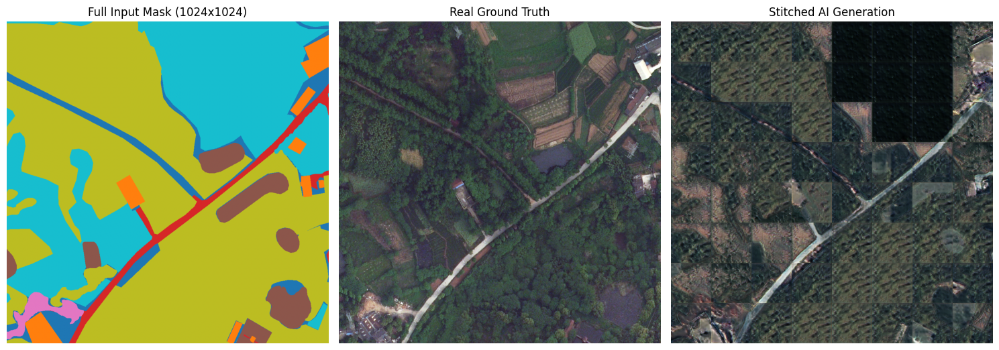

In [8]:
def generate_full_image(generator, large_mask_tensor, patch_size=128):
    """
    Takes a full resolution mask tensor (e.g., 7x1024x1024),
    splits it into patches, generates images, and stitches them back.
    """
    _, h, w = large_mask_tensor.size()
    
    # Create a blank canvas for the result (3 channels for RGB)
    full_fake_image = torch.zeros((3, h, w))
    
    # Calculate how many patches fit
    n_rows = h // patch_size
    n_cols = w // patch_size
    
    generator.eval()
    
    with torch.no_grad():
        for r in range(n_rows):
            for c in range(n_cols):
                # 1. Define the coordinates
                y1 = r * patch_size
                y2 = y1 + patch_size
                x1 = c * patch_size
                x2 = x1 + patch_size
                
                # 2. Extract the patch from the mask
                # Shape: [1, 7, 128, 128]
                mask_patch = large_mask_tensor[:, y1:y2, x1:x2].unsqueeze(0).to(DEVICE)
                
                # 3. Generate the fake image patch
                fake_patch = generator(mask_patch)
                
                # 4. Remove batch dim and move to CPU
                fake_patch = fake_patch[0].cpu()
                
                # 5. Paste it onto the canvas
                full_fake_image[:, y1:y2, x1:x2] = fake_patch
                
    return full_fake_image

# --- Settings ---
# We pick a random file from the Validation folder
val_img_path = glob.glob(os.path.join(DATA_ROOT, 'Val', 'Urban', 'images_png', '*.png'))[5] # Index 5
val_mask_path = val_img_path.replace('images_png', 'masks_png')

print(f"Processing Full Image: {val_img_path}")

# 1. Load Ground Truths (No Cropping!)
full_img_pil = Image.open(val_img_path).convert('RGB')
full_mask_pil = Image.open(val_mask_path)

# 2. Preprocess Mask (Fix indices 1-7 -> 0-6)
mask_np = np.array(full_mask_pil)
if mask_np.max() >= NUM_CLASSES:
    mask_np = mask_np - 1
mask_np = np.clip(mask_np, 0, NUM_CLASSES - 1)
# Convert to One-Hot Tensor [7, 1024, 1024]
full_mask_tensor = torch.tensor(mask_np, dtype=torch.long)
full_mask_onehot = F.one_hot(full_mask_tensor, num_classes=NUM_CLASSES).permute(2, 0, 1).float()

# 3. Preprocess Real Image (For comparison)
full_real_tensor = transforms.functional.to_tensor(full_img_pil)
full_real_tensor = transforms.functional.normalize(full_real_tensor, [0.5]*3, [0.5]*3)

# 4. RUN THE STITCHING FUNCTION
print("⏳ Generating tiles... this might take a moment on M1...")
start = time.time()
full_generated_tensor = generate_full_image(G, full_mask_onehot, patch_size=128)
print(f"✅ Done in {time.time() - start:.2f} seconds.")

# 5. Visualize
def denorm_numpy(t):
    return t.permute(1, 2, 0).numpy() * 0.5 + 0.5

plt.figure(figsize=(15, 6))

# Show Mask
plt.subplot(1, 3, 1)
plt.imshow(mask_np, cmap='tab10')
plt.title("Full Input Mask (1024x1024)")
plt.axis('off')

# Show Real
plt.subplot(1, 3, 2)
plt.imshow(denorm_numpy(full_real_tensor))
plt.title("Real Ground Truth")
plt.axis('off')

# Show Generated
plt.subplot(1, 3, 3)
plt.imshow(denorm_numpy(full_generated_tensor))
plt.title("Stitched AI Generation")
plt.axis('off')

plt.tight_layout()
plt.show()


